In [4]:
# !pip install nbformat
# !jupyter nbconvert --to script Kuramoto.ipynb
%run ./Kuramoto.ipynb

# Linear regression to get the coefficient of sigma-2 in exponent

In [50]:
escape_df_range = escape_df[10:70]
escape_df_range['sigma_in_sq'] = escape_df_range['sigma_in']**2

Xdf = escape_df_range.filter(['sigma_in_sq'], axis=1)
Ydf = np.log(escape_df_range.filter(['escape_time'], axis=1))

lm =  LinearRegression()
lm.fit(Xdf,Ydf) 

Y_pred = lm.predict(Xdf)
Y_true = np.array(Ydf)
rss = (sum(np.power((Y_pred - Y_true), 2))/len(Y_pred))**0.5
 
 
print(f"sigma square coef: {lm.coef_},  y-intercept: {lm.intercept_}, error rrs: {rss}")


sigma square coef: [[0.2806526]],  y-intercept: [0.18566158], error rrs: [0.11584653]


/var/folders/ld/myyy3ll5499__8dh61ly1gz40000gn/T/ipykernel_15666/3654036250.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  escape_df_range['sigma_in_sq'] = escape_df_range['sigma_in']**2


# Figure for escape times of complex-square+noise Markov Chaing

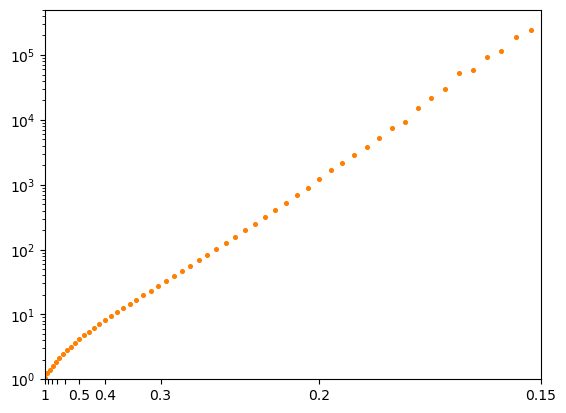

In [274]:
# cuadratic escape function list
# starting_time = time.time()
# iterations = 10000000

# sigmas_inverses = np.linspace(0.1, 10, 100) 
# cuadratic_esacpe_list = [cuadratic_escape_function(1/si, iterations) for si in sigmas_inverses]



# ending_time = time.time()
# print("Time elapsed :", (ending_time-starting_time)/60)


# escape_df = pd.DataFrame(columns = ['sigma_in', 'escape_time'])
# escape_df['sigma_in']= sigmas_inverses
# escape_df['escape_time']= cuadratic_esacpe_list
# escape_df.to_csv('escape_time_values.csv')

escape_df = pd.read_csv('escape_time_values.csv', index_col = 0)

x_max = 8

# plt.figure(figsize=(15,15)) 
plt.xlim(1,x_max)
plt.ylim(1,5e5)
plt.yscale('log')
plt.scatter(escape_df['sigma_in']**2, escape_df['escape_time'], color =(1,0.5,0), s = 7)

# x_range = np.arange(1,x_max,0.1)
# plt.plot(x_range**2, np.exp(0.18 + 0.28*x_range**2))

# Customize the y-axis tick labels
x_ticks = np.array([1, 0.9,0.8, 0.7, 0.6, 0.5 ,0.4, 0.3, 0.2, 0.15])
x_ticks_lab = [1, '', ' ','', ' ', 0.5 ,0.4, 0.3, 0.2, 0.15]
plt.xticks((1/x_ticks)**2, x_ticks_lab)

file_name = 'complex_square_noise.png'
plt.savefig(file_name)

plt.show()


In [116]:
starting_time = time.time()

cef_list2 = np.array(cuadratic_escape_function_list(0.36, 1000000, until_r = 5))

ext_time2, stan_dev, climb2 = expected_value_constant_plus_exp(cef_list2)

ending_time = time.time()
print("Time elapsed :", np.around((ending_time-starting_time)/60, 2))

ext_time2

Time elapsed : 0.02


12.082696648723736

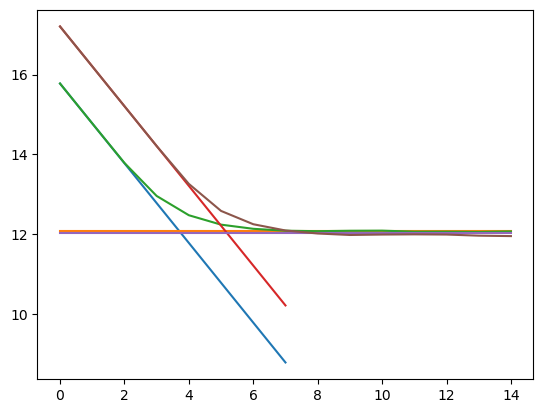

In [118]:
list_val = cef_list2

border_in = np.arange(0,15, 1)

ext_time, stan_dev, climb = expected_value_constant_plus_exp(list_val)


mean_out2 = [np.mean(list_val[list_val >= b])-b for b in border_in]

constant2 = [ext_time+ climb - x for x in border_in] 
exp2 = [ext_time for _ in border_in]

# plt.plot(border_in,std_out)

plt.plot(border_in[:8],constant2[:8])
plt.plot(border_in,exp2)
plt.plot(border_in,mean_out2)


plt.plot(border_in[:8],constant[:8])
plt.plot(border_in,exp)
plt.plot(border_in,mean_out)


plt.show()

In [335]:
starting_time = time.time()

cef_list = np.array(cuadratic_escape_function_list(0.36, 100000000))

ext_time, stan_dev, climb = expected_value_constant_plus_exp(cef_list)


np.savetxt("cuadratic_escape_function_list_036.csv", cef_list, delimiter=",")

ending_time = time.time()
print("Time elapsed :", np.around((ending_time-starting_time)/60, 2))

ext_time

Time elapsed : 1.72


11.98331876810217

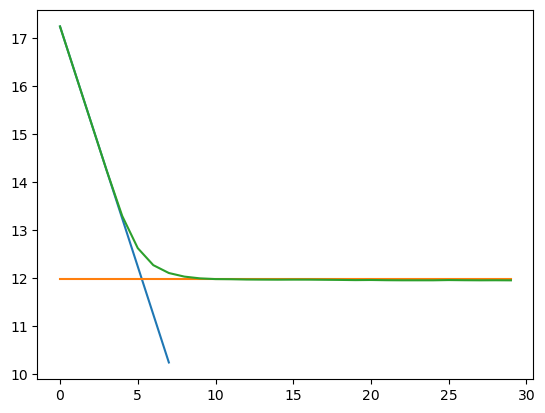

In [336]:



list_val = cef_list

border_in = np.arange(0,30, 1)

ext_time, stan_dev, climb = expected_value_constant_plus_exp(list_val)


mean_out = [np.mean(list_val[list_val >= b])-b for b in border_in]
std_out = [np.std(list_val[list_val >= b]) for b in border_in]

constant = [ext_time+ climb - x for x in border_in] 
exp = [ext_time for _ in border_in]

# plt.plot(border_in,std_out)

plt.plot(border_in[:8],constant[:8])
plt.plot(border_in,exp)
plt.plot(border_in,mean_out)

df = pd.DataFrame({"x": border_in, "E(T-x|T>=x)": mean_out})
df.to_csv('fig3_constant_plus_exp_csnMC.csv')


file_name = 'constant_plus_exp_csnMC.png'
plt.savefig(file_name)


plt.show()

In [132]:
%run ./Kuramoto.ipynb

In [133]:
N = 50000
C = 500
gamma = 4
alpha = 12

mod1 = init_Kuramoto_invGamma_file(N, C, gamma, maxW=10, filename = "_", verbose = True)
mod1.set_alpha(alpha)


Generating model from edge-list. N=50000, C=500, g=4


In [119]:
# starting_time = time.time()



# list_of_times = mod1.expected_stages_to_sync(1000000)

# ending_time = time.time()
# print("Time elapsed :", np.around((ending_time-starting_time)/60, 2))

# took 14 hours to run with 1,000,000 steps

#np.save('list_times_1Msteps_N50K_C500_a12_g4.npy', list_of_times)
# np.savetxt("list_times_1Msteps_N50K_C500_a12_g4.csv", list_of_times, delimiter=",")


Time elapsed : 828.93


In [24]:
list_of_times = np.load('list_times_1Msteps_N50K_C500_a12_g4.npy')



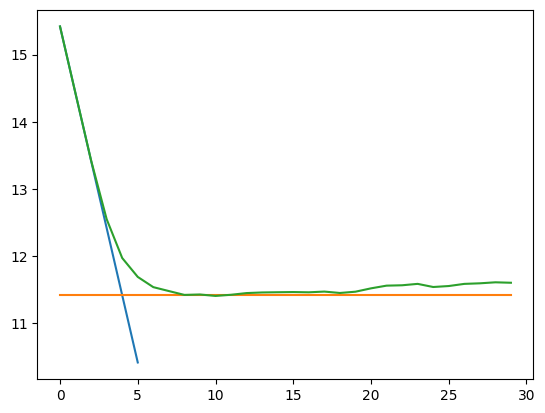

In [26]:
# list of times with new until_r
list_of_times_nu = np.loadtxt('list_times_1Msteps_N50K_C500_a12_g4_withNEWuntilr_May1.csv')


list_val = np.array(list_of_times_nu)

border_in = np.arange(0,30, 1)

ext_time, stan_dev, climb = expected_value_constant_plus_exp(list_val)


mean_out_nu = [np.mean(list_val[list_val >= b])-b for b in border_in]
std_out = [np.std(list_val[list_val >= b]) for b in border_in]

constant = [ext_time+ climb - x for x in border_in] 
exp = [ext_time for _ in border_in]


plt.plot(border_in[:6],constant[:6])
plt.plot(border_in,exp)
plt.plot(border_in,mean_out_nu)

df = pd.DataFrame({"x": border_in, "E(T-x|T>=x)": mean_out_nu})
df.to_csv('fig3_constant_plus_exp_Model1.csv')

file_name = 'constant_plus_exp_Model1.png'
plt.savefig(file_name)


plt.show()
print(ext_time, climb)

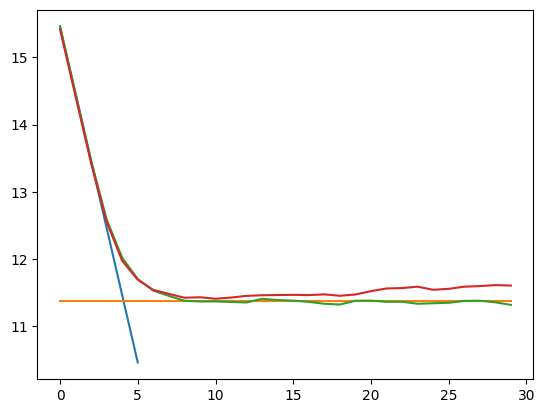

In [28]:

list_val = np.array(list_of_times)

border_in = np.arange(0,30, 1)

ext_time, stan_dev, climb = expected_value_constant_plus_exp(list_val)


mean_out = [np.mean(list_val[list_val >= b])-b for b in border_in]
std_out = [np.std(list_val[list_val >= b]) for b in border_in]

constant = [ext_time+ climb - x for x in border_in] 
exp = [ext_time for _ in border_in]


plt.plot(border_in[:6],constant[:6])
plt.plot(border_in,exp)
plt.plot(border_in,mean_out)
plt.plot(border_in,mean_out_nu)

df = pd.DataFrame({"x": border_in, "E(T-x|T>=x)": mean_out})
df.to_csv('fig3_constant_plus_exp_Model1.csv')

file_name = 'constant_plus_exp_Model1.png'
plt.savefig(file_name)


plt.show()

In [128]:
mod1.sim_escape

11.450744450744452

In [3]:
df = pd.read_csv('data_Model1_15000.csv', index_col=0)
df

,N,alpha,C,gamma,maxW,sim_escape,estimated_spark_time,k_coeficient,coefLR,sigma,...,kbeta,M2,M3,preciscion_esc,limit_r_forced,std_r_forced,number_of_iterates,climb,sbeta,graph_filename
0,30000,10,300.0,3,10,3.280854,4.369886,81.293823,58.312336,0.005974,...,5.479943,2.141516,8.672748,0.092281,0.339885,0.032803,15000.0,3.090644,1.735166,invGamma_graph_30000_300_3_10.txt
0,30000,10,300.0,4,10,21.085774,35.029237,54.359225,52.688849,0.005308,...,3.516514,1.690176,5.090892,0.964441,0.369647,0.053166,15000.0,4.048372,1.434488,invGamma_graph_30000_300_4_10.txt
0,30000,10,300.0,5,10,305.682927,1351.140625,40.210893,41.405372,0.004923,...,2.522978,1.454388,3.364635,47.739653,0.378966,0.072076,15000.0,12.487286,1.135871,invGamma_graph_30000_300_5_10.txt
0,30000,10,500.0,4,10,11.338889,17.213402,62.694917,59.124672,0.005308,...,4.055755,1.690183,5.090968,0.422575,0.373856,0.050505,15000.0,4.127631,1.910128,invGamma_graph_30000_500_4_10.txt
0,30000,10,500.0,3,10,2.269644,2.863221,97.152439,63.856935,0.005974,...,6.548961,2.141523,8.672803,0.065275,0.347605,0.042267,15000.0,2.921441,2.398651,invGamma_graph_30000_500_3_10.txt
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,100000,12,1000.0,4,10,31.862170,56.709370,92.993058,92.702488,0.002907,...,4.315242,1.690186,5.091016,1.725433,0.338638,0.059996,15000.0,5.115045,2.155160,invGamma_graph_100000_1000_4_10.txt
0,100000,12,1000.0,5,10,1670.875000,8053.300000,65.455400,66.916436,0.002697,...,2.958379,1.454396,3.364782,590.743522,0.346658,0.075838,15000.0,0.000000,1.621805,invGamma_graph_100000_1000_5_10.txt
0,100000,15,1000.0,3,10,1.769527,2.236777,200.206981,109.379068,0.003272,...,6.330216,2.141515,8.672761,0.054950,0.284251,0.037968,15000.0,2.669559,2.257903,invGamma_graph_100000_1000_3_10.txt
0,100000,15,1000.0,4,10,7.336933,10.423052,128.511906,108.773309,0.002907,...,3.946637,1.690186,5.091016,0.241107,0.293927,0.063083,15000.0,3.447042,1.810077,invGamma_graph_100000_1000_4_10.txt


In [11]:
df.columns

Index(['N', 'alpha', 'C', 'gamma', 'maxW', 'sim_escape',
       'estimated_spark_time', 'k_coeficient', 'coefLR', 'sigma', 'rss',
       'kbeta', 'M2', 'M3', 'preciscion_esc', 'limit_r_forced', 'std_r_forced',
       'number_of_iterates', 'climb', 'sbeta', 'graph_filename',
       'MC_coef_inverse'],
      dtype='object')

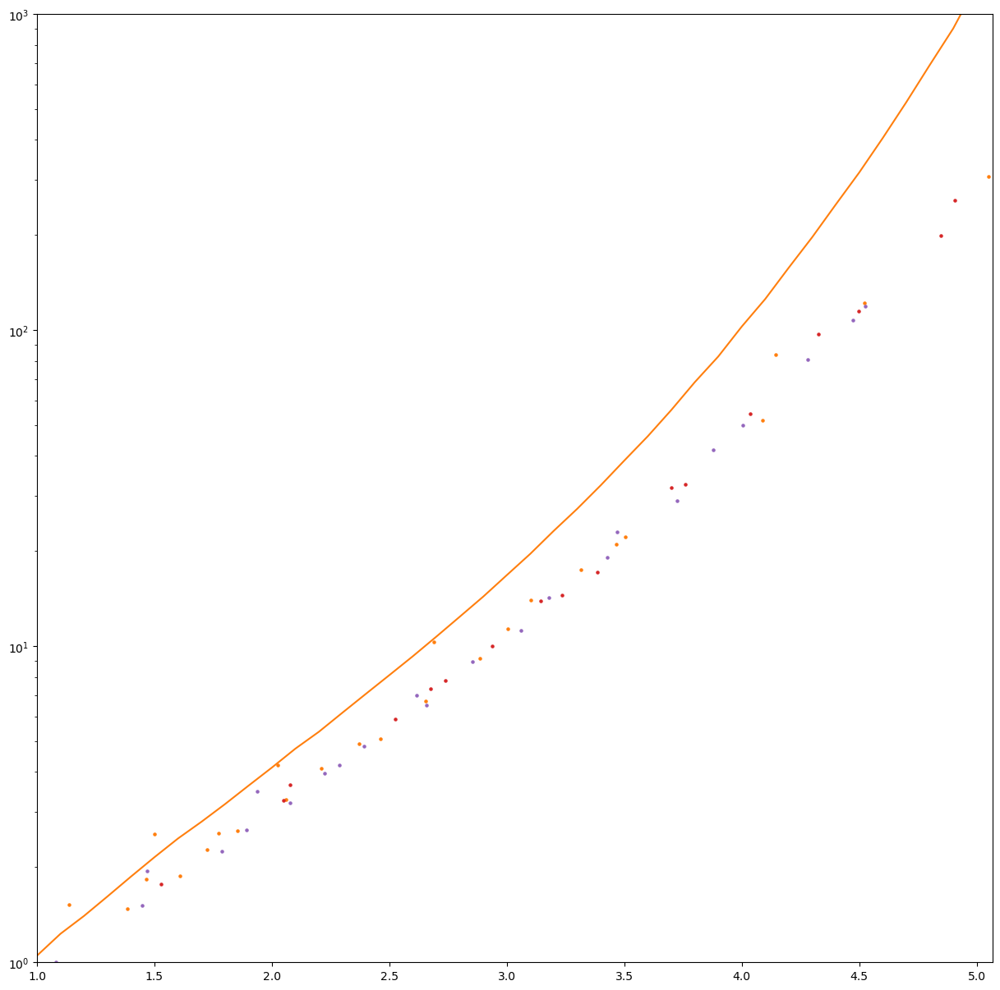

In [16]:
df = pd.read_csv('data_Model1_15000.csv', index_col=0)
df['MC_coef_inverse'] = 1/(df.k_coeficient*df.sigma)

plt.figure(figsize=(15,15)) 
plt.xlim(1,25/(math.pi**2/2))
plt.ylim(1,1000)
plt.yscale('log')

mi = min(df.M2)
ma = max(df.M2)
dfN = df[df.N==100000]
rng = [(dm-mi)/(ma-mi) for dm in dfN.M2]
colorsM2_100000 = [(dm, 1-dm, dm) for dm in rng]

dfN = df[df.N==50000]
rng = [(dm-mi)/(ma-mi) for dm in dfN.M2]
colorsM2_10000 = [(dm, 1-dm, dm) for dm in rng]

dfN = df[df.N==30000]
rng = [(dm-mi)/(ma-mi) for dm in dfN.M2]
colorsM2_30000 = [(dm, 1-dm, dm) for dm in rng]


plt.scatter(df.MC_coef_inverse[df.N==30000], (df.sim_escape[df.N==30000]), c =['#ff7f0e'], s = 5)      #['#1f77b4']
plt.scatter(df.MC_coef_inverse[df.N==100000], (df.sim_escape[df.N==100000]), c =['#d62728'], s = 5)   #['#d62728']
plt.scatter(df.MC_coef_inverse[df.N==50000], (df.sim_escape[df.N==50000]), c = ['#9467bd'], s = 5)     #['#9467bd']

# plt.plot(escape_df['sigma_in']*math.pi**2/2, escape_df['escape_time'], c ='#ff7f0e')
plt.plot(escape_df['sigma_in'], escape_df['escape_time'], c ='#ff7f0e')


# file_name = 'calcCoef_vs_ExptectedSync_new.png'
# plt.savefig(file_name)

plt.show()

In [ ]:
data_Model1_added_30000.csv

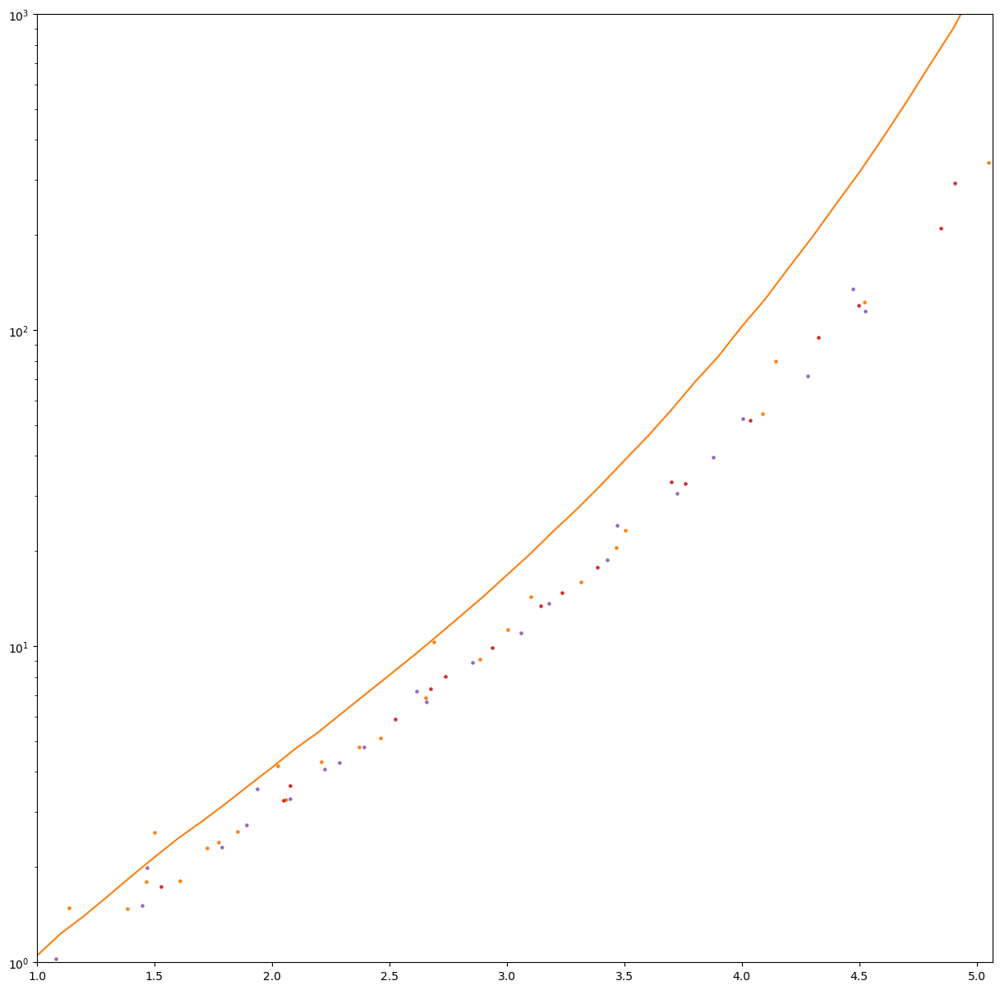

In [160]:
df = pd.read_csv('data_Model1_added_30000.csv', index_col=0)
df['MC_coef_inverse'] = 1/(df.k_coeficient*df.sigma)

plt.figure(figsize=(15,15)) 
plt.xlim(1,25/(math.pi**2/2))
plt.ylim(1,1000)
plt.yscale('log')

mi = min(df.M2)
ma = max(df.M2)
dfN = df[df.N==100000]
rng = [(dm-mi)/(ma-mi) for dm in dfN.M2]
colorsM2_100000 = [(dm, 1-dm, dm) for dm in rng]

dfN = df[df.N==50000]
rng = [(dm-mi)/(ma-mi) for dm in dfN.M2]
colorsM2_10000 = [(dm, 1-dm, dm) for dm in rng]

dfN = df[df.N==30000]
rng = [(dm-mi)/(ma-mi) for dm in dfN.M2]
colorsM2_30000 = [(dm, 1-dm, dm) for dm in rng]


plt.scatter(df.MC_coef_inverse[df.N==30000], (df.sim_escape[df.N==30000]), c =['#ff7f0e'], s = 5)      #['#1f77b4']
plt.scatter(df.MC_coef_inverse[df.N==100000], (df.sim_escape[df.N==100000]), c =['#d62728'], s = 5)   #['#d62728']
plt.scatter(df.MC_coef_inverse[df.N==50000], (df.sim_escape[df.N==50000]), c = ['#9467bd'], s = 5)     #['#9467bd']

# plt.plot(escape_df['sigma_in']*math.pi**2/2, escape_df['escape_time'], c ='#ff7f0e')
plt.plot(escape_df['sigma_in'], escape_df['escape_time'], c ='#ff7f0e')
# plt.plot(escape_df['sigma_in'], np.exp(escape_df['sigma_in']**2/4), c ='#ff7f0e')


# file_name = 'calcCoef_vs_ExptectedSync_new.png'
# plt.savefig(file_name)

plt.show()

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


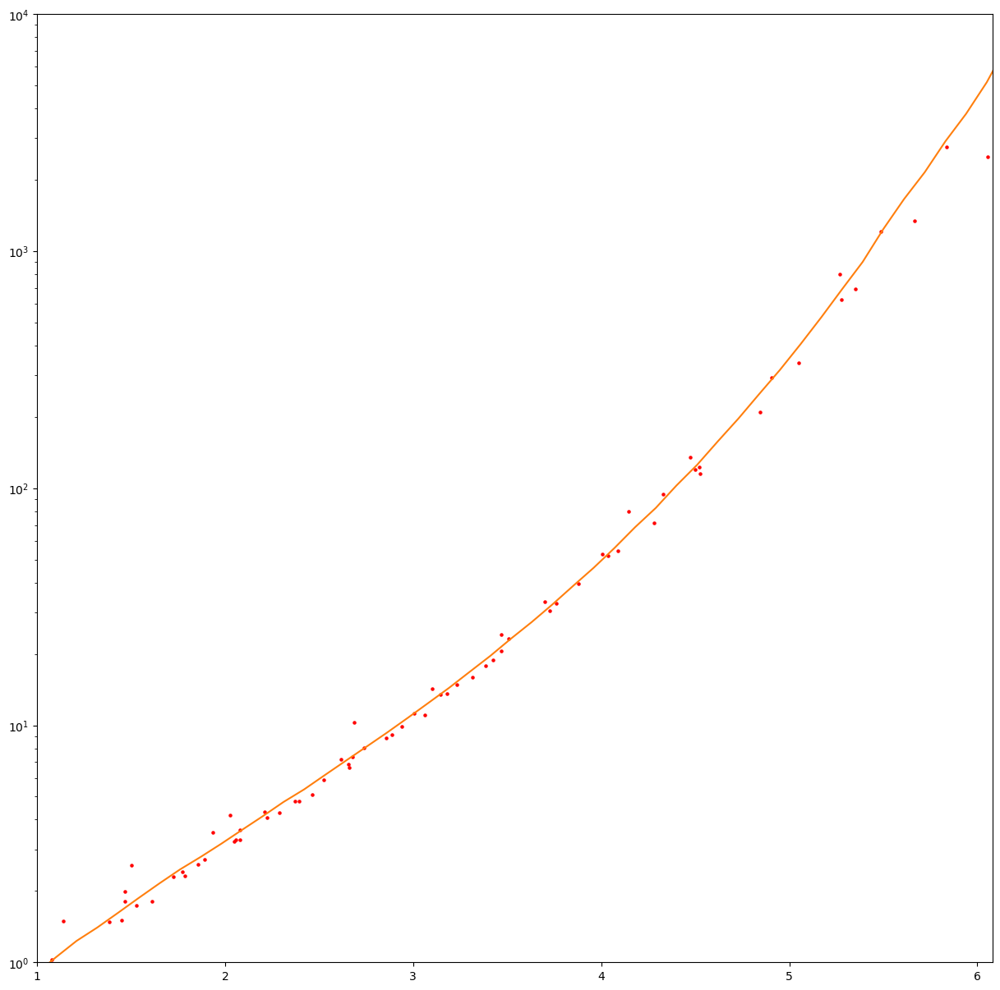

In [38]:
df3 = pd.read_csv('data_Model1_added_30000.csv', index_col=0)
df3['MC_coef_inverse'] = 1/(df3.k_coeficient*df3.sigma)

df1 = pd.read_csv('data_Model1_15000.csv', index_col=0)
df1['MC_coef_inverse'] = 1/(df1.k_coeficient*df1.sigma)

plt.figure(figsize=(15,15)) 
plt.xlim(1,30/(math.pi**2/2))
plt.ylim(1,10000)
plt.yscale('log')


# plt.scatter(df1.MC_coef_inverse, df1.sim_escape, c =(1,0,0), s = 5)      #['#1f77b4']
plt.scatter(df3.MC_coef_inverse, df3.sim_escape, c =(1,0,0), s = 5)      #['#1f77b4']

plt.plot(escape_df['sigma_in']*1.1, escape_df['escape_time'], c ='#ff7f0e')


# file_name = 'MC_coef_inverse_vs_sim_escape_30000.png'
# plt.savefig(file_name)

plt.show()

In [107]:
escape_df = pd.read_csv('escape_time_values.csv', index_col = 0)


*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


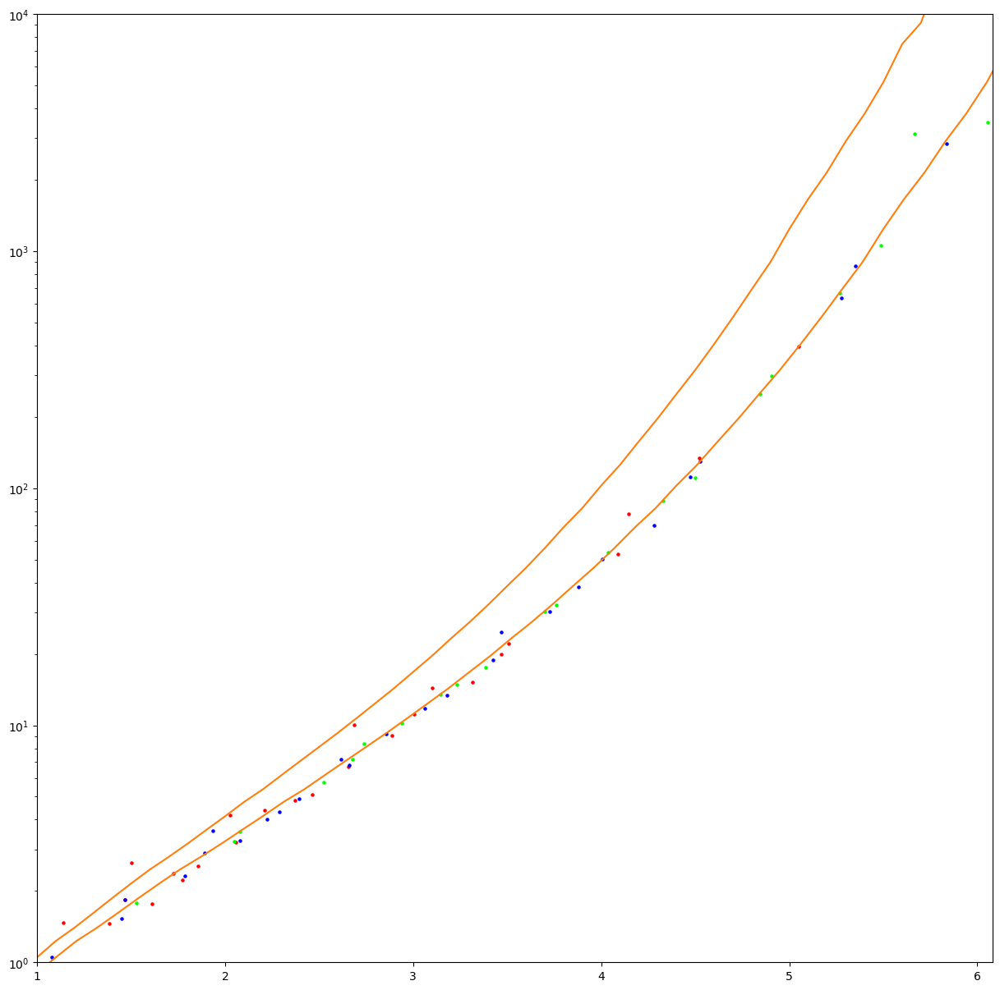

In [130]:
df3 = pd.read_csv('data_Model1_100000.csv', index_col=0)
df3['MC_coef_inverse'] = 1/(df3.k_coeficient*df3.sigma)

df1 = pd.read_csv('data_Model1_15000.csv', index_col=0)
df1['MC_coef_inverse'] = 1/(df1.k_coeficient*df1.sigma)

plt.figure(figsize=(15,15)) 
plt.xlim(1,30/(math.pi**2/2))
plt.ylim(1,10000)
plt.yscale('log')


plt.scatter(df3.MC_coef_inverse[df3.N==30000], (df3.sim_escape[df3.N==30000]), c =(1,0,0), s = 5)      #['#1f77b4']
plt.scatter(df3.MC_coef_inverse[df3.N==100000], (df3.sim_escape[df3.N==100000]), c =(0,1,0), s = 5)   #['#d62728']
plt.scatter(df3.MC_coef_inverse[df3.N==50000], (df3.sim_escape[df3.N==50000]), c = (0,0,1), s = 5)     #['#9467bd']





# plt.scatter(df1.MC_coef_inverse, df1.sim_escape, c =(1,0,0), s = 5)      #['#1f77b4']
# plt.scatter(df3.MC_coef_inverse, df3.sim_escape, c =(1,0,0), s = 5)      #['#1f77b4']

plt.plot(escape_df['sigma_in'], escape_df['escape_time'], c ='#ff7f0e')
plt.plot(escape_df['sigma_in']*1.1, escape_df['escape_time'], c ='#ff7f0e')


# file_name = 'MC_coef_inverse_vs_sim_escape_30000.png'
# plt.savefig(file_name)

plt.show()

In [3]:
df3 = pd.read_csv('data_Model1_100000.csv', index_col=0)
df3

,N,alpha,C,gamma,maxW,sim_escape,estimated_spark_time,k_coeficient,coefLR,sigma,...,kbeta,M2,M3,preciscion_esc,limit_r_forced,std_r_forced,number_of_iterates,climb,sbeta,graph_filename
0,30000,10,300.0,3,10,3.220181,4.466823,81.293823,57.997229,0.005974,...,5.479943,2.141516,8.672748,0.035169,0.340007,0.034648,100000.0,3.053148,1.735166,invGamma_graph_30000_300_3_10.txt
0,30000,10,300.0,4,10,19.939476,35.110393,54.359225,53.440820,0.005308,...,3.516514,1.690176,5.090892,0.346003,0.369811,0.051671,100000.0,4.383644,1.434488,invGamma_graph_30000_300_4_10.txt
0,30000,10,300.0,5,10,397.683962,1518.428571,40.210893,42.034924,0.004923,...,2.522978,1.454388,3.364635,27.313047,0.377651,0.076103,100000.0,19.730264,1.135871,invGamma_graph_30000_300_5_10.txt
0,30000,10,500.0,3,10,2.364236,2.826632,97.152439,60.754345,0.005974,...,6.548961,2.141523,8.672803,0.026625,0.346738,0.035745,100000.0,2.822031,2.398651,invGamma_graph_30000_500_3_10.txt
0,30000,10,500.0,4,10,11.113955,17.037855,62.694917,58.083999,0.005308,...,4.055755,1.690183,5.090968,0.159686,0.375183,0.057518,100000.0,4.096289,1.910128,invGamma_graph_30000_500_4_10.txt
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,100000,12,1000.0,4,10,30.156688,57.854340,92.993058,92.172762,0.002907,...,4.315242,1.690186,5.091016,0.621424,0.337692,0.058278,100000.0,4.957794,2.155160,invGamma_graph_100000_1000_4_10.txt
0,100000,12,1000.0,5,10,3117.620690,16242.600000,65.455400,68.074359,0.002697,...,2.958379,1.454396,3.364782,578.927628,0.003458,0.001539,100000.0,0.000000,1.621805,invGamma_graph_100000_1000_5_10.txt
0,100000,15,1000.0,3,10,1.778119,2.188392,200.206981,107.873555,0.003272,...,6.330216,2.141515,8.672761,0.021504,0.284886,0.037718,100000.0,2.611027,2.257903,invGamma_graph_100000_1000_3_10.txt
0,100000,15,1000.0,4,10,7.204163,10.431647,128.511906,109.208010,0.002907,...,3.946637,1.690186,5.091016,0.090807,0.293548,0.061914,100000.0,3.654132,1.810077,invGamma_graph_100000_1000_4_10.txt


/Users/antonio/Dropbox/Python/Heterogeneous Graphs/hg_env/lib/python3.9/site-packages/pandas/core/arraylike.py:402: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


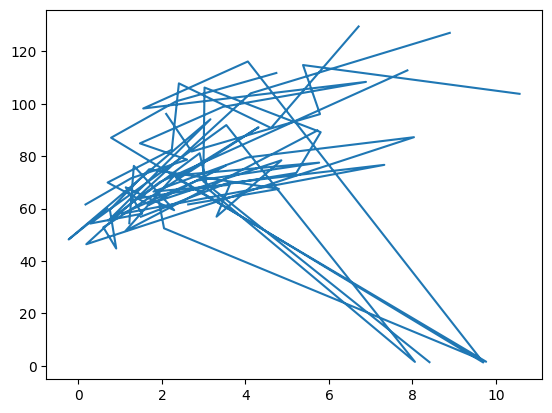

In [8]:
plt.plot(np.log(df3.estimated_spark_time), df3.limit_r_forced/df3.sigma)

# FINAL FIGURES



# Figure 1

In [ ]:
N = 100000
C = 1000
gamma = 3
maxW = 10

# w_vec = w_truncated_inverse_gamma(N, gamma, maxW)
mod = init_Kuramoto_invGamma_file(N, C, gamma, maxW=maxW, verbose = True)


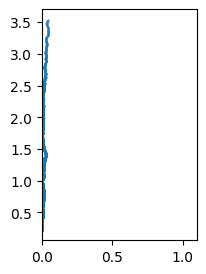

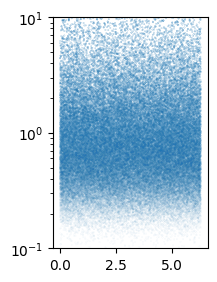

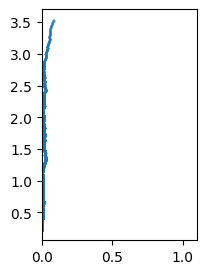

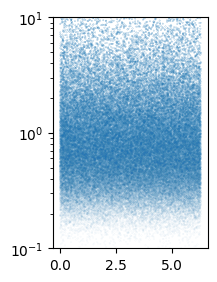

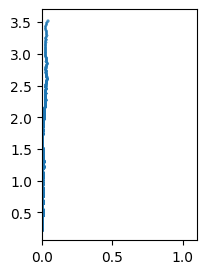

...

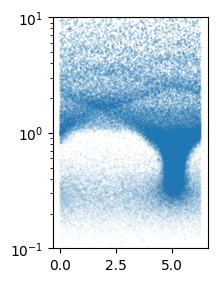

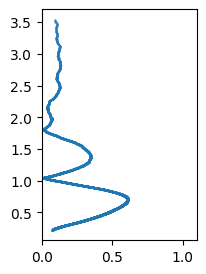

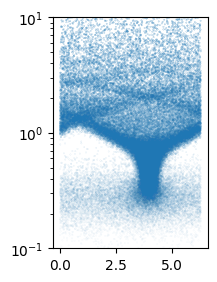

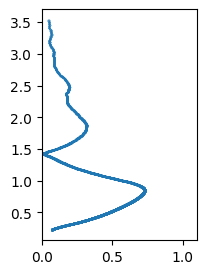

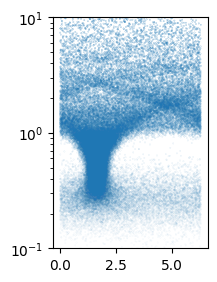

In [41]:


mod.set_alpha(15)
mod.set_uniform()

splits = 10000
Ni = 10000

steps = (N-Ni)//splits

states_df = pd.DataFrame({"w_vector": mod.w_vector})
bins_df = pd.DataFrame({"bins": list(range(0, splits+1))})

for ti in range(20):
    mod.one_step()
    rs = []
    ws = []
    
    for s in range(0, splits+1):
        min_i = steps * s 
        max_i = steps * s + Ni
        
        cos_vector_i = mod.cos_vector[min_i:max_i]
        sin_vector_i = mod.sin_vector[min_i:max_i]
        w_vector_i = mod.w_vector[min_i:max_i]

        c = np.dot(cos_vector_i, w_vector_i)/Ni
        s = np.dot(sin_vector_i, w_vector_i)/Ni

        r_i, theta_i = length_angle((c, s))
        rs.append(r_i)
        ws.append(np.mean(w_vector_i))
        
    bins_df['r_w'+str(ti)] = rs
    states_df['theta'+str(ti)] = mod.th_vector

    plt.figure(figsize=(2,3)) 
    plt.xlim(0,1.1)
    plt.scatter(rs, ws, s= 0.1)
    
    file_name = 'r_by_w_time_' + str(ti)+ '.png'
    plt.savefig(file_name)
    plt.show()
    

    
    plt.figure(figsize=(2,3)) 
    plt.yscale('log')
    plt.ylim(0.1,10)
    plt.scatter(mod.th_vector, mod.w_vector, s= (mod.w_vector)/500)

    file_name = 'scatter_points_time_' + str(ti)+ '.png'
    plt.savefig(file_name)
    plt.show()

    
bins_df['w_means'] = ws

bins_df.to_csv("fig1_r_by_bins.csv")
states_df.to_csv("fig1_state_by_steps.csv")

# Figure 2

In [11]:
# Using better until_r of limit_r/2
df = pd.read_csv('data_Model1_100000_May1.csv', index_col=0)


/var/folders/ld/myyy3ll5499__8dh61ly1gz40000gn/T/ipykernel_65599/3184161249.py:17: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  plt.scatter(fig2A_data_scattered.s_squared_inverse, fig2A_data_scattered.sim_escape, c =(0,0.7,0.3), s = 2)      #['#1f77b4']


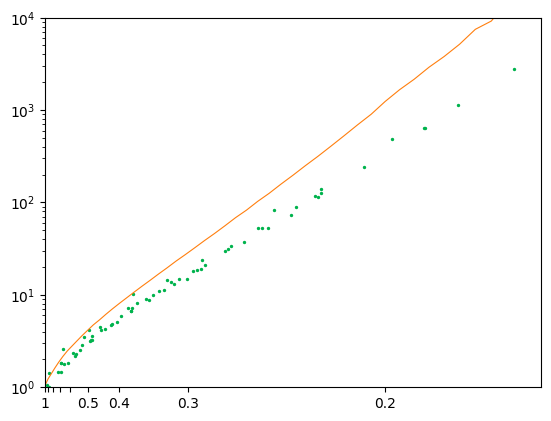

In [18]:
df['s'] = df.k_coeficient * df.sigma
df['s_squared_inverse'] = df.s ** (-2)

fig2A_data_scattered = df[['s', 's_squared_inverse', 'sim_escape', 'N']]


escape_df['sigma'] = 1/ escape_df.sigma_in
escape_df['sigma_squared_inverse'] = escape_df.sigma_in**2
fig2A_data_line = escape_df[['sigma', 'sigma_squared_inverse', 'escape_time']]

max_x = 6
plt.xlim(1,(max_x)**2)
plt.ylim(1,10000)
plt.yscale('log')


plt.scatter(fig2A_data_scattered.s_squared_inverse, fig2A_data_scattered.sim_escape, c =(0,0.7,0.3), s = 2)      #['#1f77b4']



plt.plot(fig2A_data_line.sigma_squared_inverse, fig2A_data_line['escape_time'], c ='#ff7f0e', linewidth = 0.8)


# Customize the y-axis tick labels
x_ticks = np.array([1, 0.9,0.8, 0.7, 0.6, 0.5 ,0.4, 0.3, 0.2])
x_ticks_lab = [1, '', ' ','', ' ', 0.5 ,0.4, 0.3, 0.2]
plt.xticks((1/x_ticks)**2, x_ticks_lab)

# file_name = 'MC_coef_vs_sim_escape_100000_scaled.png'
# plt.savefig(file_name)

plt.show()

fig2A_data_scattered.to_csv("fig2A_data_scattered.csv")
fig2A_data_line.to_csv("fig2A_data_line.csv")

In [14]:
df3 = pd.read_csv('data_Model1_100000_server.csv', index_col=0)
escape_df = pd.read_csv('escape_time_values.csv', index_col = 0)


/var/folders/ld/myyy3ll5499__8dh61ly1gz40000gn/T/ipykernel_65599/3179233364.py:17: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  plt.scatter(fig2A_data_scat.s_squared_inverse, fig2A_data_scat.sim_escape, c =(0,0.7,0.3), s = 2)      #['#1f77b4']
/var/folders/ld/myyy3ll5499__8dh61ly1gz40000gn/T/ipykernel_65599/3179233364.py:18: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  plt.scatter(fig2A_data_scattered.s_squared_inverse, fi

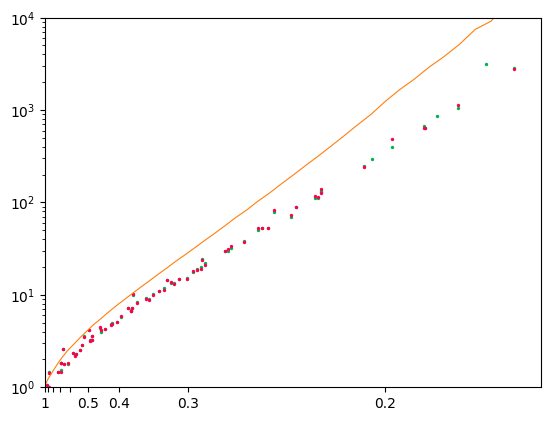

In [17]:
df3['s'] = df3.k_coeficient * df3.sigma
df3['s_squared_inverse'] = df3.s ** (-2)

fig2A_data_scat = df3[['s', 's_squared_inverse', 'sim_escape', 'N']]


escape_df['sigma'] = 1/ escape_df.sigma_in
escape_df['sigma_squared_inverse'] = escape_df.sigma_in**2
fig2A_data_line = escape_df[['sigma', 'sigma_squared_inverse', 'escape_time']]

max_x = 6
plt.xlim(1,(max_x)**2)
plt.ylim(1,10000)
plt.yscale('log')


plt.scatter(fig2A_data_scat.s_squared_inverse, fig2A_data_scat.sim_escape, c =(0,0.7,0.3), s = 2)      #['#1f77b4']
plt.scatter(fig2A_data_scattered.s_squared_inverse, fig2A_data_scattered.sim_escape, c =(1,0,0.3), s = 2)      #['#1f77b4']



plt.plot(fig2A_data_line.sigma_squared_inverse, fig2A_data_line['escape_time'], c ='#ff7f0e', linewidth = 0.8)


# Customize the y-axis tick labels
x_ticks = np.array([1, 0.9,0.8, 0.7, 0.6, 0.5 ,0.4, 0.3, 0.2])
x_ticks_lab = [1, '', ' ','', ' ', 0.5 ,0.4, 0.3, 0.2]
plt.xticks((1/x_ticks)**2, x_ticks_lab)

file_name = 'MC_coef_vs_sim_escape_100000_scaled.png'
plt.savefig(file_name)

plt.show()

fig2A_data_scat.to_csv("fig2A_data_scat.csv")
fig2A_data_line.to_csv("fig2A_data_line.csv")

In [ ]:
df = pd.read_csv('data_Model1_100000_forAlphas.csv', index_col=0)

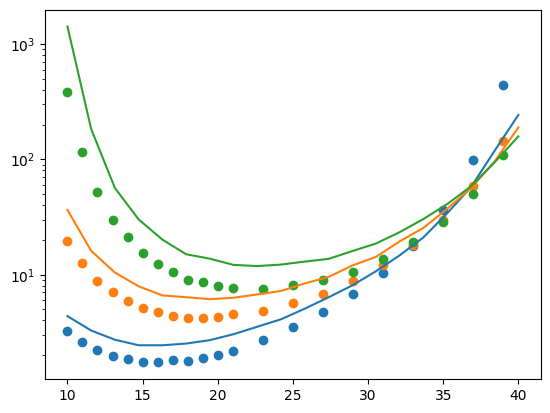

In [36]:


fig2B_gamma_vs_escape = df[['gamma', 'alpha', 'sim_escape']]

alphas = np.linspace(10, 40, 20)
N = 30000
maxW=10
C = 300

fig2B_lines =pd.DataFrame({'alphas': alphas})

for gamma in [3,4,5]:
    w_vec = w_truncated_inverse_gamma(N, gamma, maxW)
    
    est_escapes = []

    for a in alphas:
        e = estimated_expected_time(w_vec, a, C)
        est_escapes.append(e)

    fig2B_lines['escape'+str(gamma)] = est_escapes

    plt.yscale('log')
    plt.plot(fig2B_lines.alphas, fig2B_lines['escape'+str(gamma)])
    plt.scatter(fig2B_gamma_vs_escape.alpha[fig2B_gamma_vs_escape.gamma == gamma], fig2B_gamma_vs_escape.sim_escape[fig2B_gamma_vs_escape.gamma == gamma])
    
    
    
file_name = 'escape_vs_alphas.png'
plt.savefig(file_name)


plt.show()

fig2B_gamma_vs_escape.to_csv("fig2B_gamma_vs_escape.csv")
fig2B_lines.to_csv("fig2B_lines.csv")




The following data contain smaller N

In [19]:
df01 = pd.read_csv('data_Model1_100001.csv', index_col=0)
df01

,N,alpha,C,gamma,maxW,sim_escape,estimated_spark_time,k_coeficient,coefLR,sigma,...,kbeta,M2,M3,preciscion_esc,limit_r_forced,std_r_forced,number_of_iterates,climb,sbeta,graph_filename
0,5000,10,100.0,3,10,2.360939,3.294642,37.090730,35.743803,0.014634,...,2.500238,2.141437,8.672227,0.034493,0.288604,0.020335,100001.0,5.113807,0.415091,invGamma_graph_5000_100_3_10.txt
0,5000,10,100.0,4,10,6.947066,9.564390,29.288807,29.185049,0.013001,...,1.894692,1.690131,5.089536,0.105392,0.336777,0.016709,100001.0,6.273924,0.392173,invGamma_graph_5000_100_4_10.txt
0,5000,10,100.0,5,10,18.360131,29.998516,24.751462,25.372572,0.012059,...,1.552931,1.454102,3.359861,0.350178,0.354179,0.046223,100001.0,6.675276,0.364535,invGamma_graph_5000_100_5_10.txt
0,5000,10,200.0,4,10,2.141803,2.657656,45.912999,38.696143,0.013000,...,2.970105,1.690116,5.089864,0.030247,0.361385,0.068470,100001.0,4.261292,1.006693,invGamma_graph_5000_200_4_10.txt
0,5000,12,100.0,3,10,3.175340,4.220393,33.873865,32.195111,0.014634,...,1.628406,2.141437,8.672227,0.043368,0.245022,0.024264,100001.0,5.258811,0.332902,invGamma_graph_5000_100_3_10.txt
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,50000,15,300.0,3,10,3.226134,4.513279,104.008282,103.115448,0.004628,...,3.288571,2.141514,8.672711,0.044623,0.269295,0.021945,100001.0,5.279760,0.644105,invGamma_graph_50000_300_3_10.txt
0,50000,15,300.0,4,10,13.316528,22.722929,76.477483,78.019822,0.004111,...,2.348646,1.690192,5.091085,0.225380,0.279203,0.056677,100001.0,6.591270,0.605297,invGamma_graph_50000_300_4_10.txt
0,50000,15,400.0,3,10,1.941065,2.645618,129.759560,116.424655,0.004628,...,4.102783,2.141507,8.672681,0.026764,0.273535,0.034681,100001.0,4.634844,0.993076,invGamma_graph_50000_400_3_10.txt
0,50000,15,400.0,4,10,6.750103,10.131646,91.022200,91.911588,0.004111,...,2.795318,1.690188,5.091039,0.097046,0.284604,0.062180,100001.0,5.898320,0.883350,invGamma_graph_50000_400_4_10.txt


In [20]:
df02 = pd.read_csv('data_Model1_100002.csv', index_col=0)
df02

,N,alpha,C,gamma,maxW,sim_escape,estimated_spark_time,k_coeficient,coefLR,sigma,...,kbeta,M2,M3,preciscion_esc,limit_r_forced,std_r_forced,number_of_iterates,climb,sbeta,graph_filename
0,10000,31,100.0,5,10,0.234119,0.0,8.505254,72.929145,0.008527,...,0.065033,1.454297,3.363313,0.004236,0.011310,0.005747,100002.0,0.009699,0.056424,invGamma_graph_10000_100_5_10.txt
0,10000,31,100.0,4,10,0.280657,0.0,7.608323,-59.712915,0.009193,...,0.058844,1.690143,5.090522,0.004723,0.012830,0.004268,100002.0,0.000000,0.059544,invGamma_graph_10000_100_4_10.txt
0,10000,31,100.0,3,10,0.395591,0.0,6.285549,17.963357,0.010348,...,0.049352,2.141539,8.672851,0.005131,0.017284,0.006349,100002.0,0.014158,0.060112,invGamma_graph_10000_100_3_10.txt
0,10000,33,100.0,5,10,0.273861,0.0,6.968727,69.078394,0.008527,...,0.047255,1.454297,3.363313,0.004510,0.012015,0.008579,100002.0,0.006033,0.045632,invGamma_graph_10000_100_5_10.txt
0,10000,33,100.0,3,10,0.131803,0.0,5.205603,123.213075,0.010348,...,0.036193,2.141539,8.672851,0.003375,0.011017,0.003551,100002.0,0.020838,0.048413,invGamma_graph_10000_100_3_10.txt
0,10000,33,100.0,4,10,0.280608,0.0,6.264325,83.132861,0.009193,...,0.042939,1.690143,5.090522,0.004583,0.012912,0.006496,100002.0,0.000008,0.047968,invGamma_graph_10000_100_4_10.txt
0,10000,35,100.0,5,10,0.242475,0.0,5.662761,8.005136,0.008527,...,0.034287,1.454297,3.363313,0.004459,0.011162,0.004239,100002.0,0.000000,0.036658,invGamma_graph_10000_100_5_10.txt
0,10000,35,100.0,3,10,0.226725,0.0,4.307352,-29.394446,0.010348,...,0.026705,2.141539,8.672851,0.004332,0.013201,0.008429,100002.0,0.000218,0.039071,invGamma_graph_10000_100_3_10.txt
0,10000,35,100.0,4,10,0.215438,0.0,5.131015,62.475838,0.009193,...,0.031386,1.690143,5.090522,0.004222,0.011575,0.004335,100002.0,0.002050,0.038544,invGamma_graph_10000_100_4_10.txt
0,10000,37,100.0,5,10,0.132092,0.0,4.567654,43.702688,0.008527,...,0.024845,1.454297,3.363313,0.003933,0.008354,0.006229,100002.0,0.000000,0.029290,invGamma_graph_10000_100_5_10.txt


# Figure 3
## Figure for escape times of complex-square+noise Markov Chaing

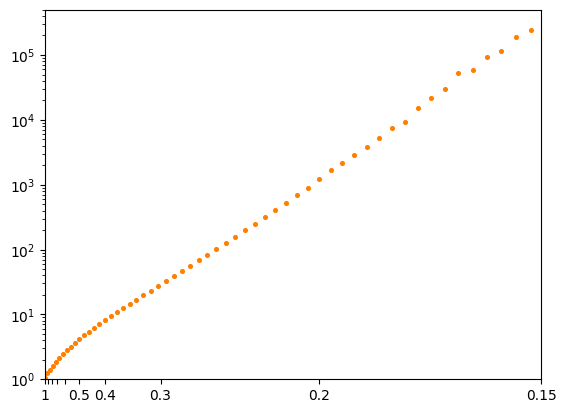

In [43]:
# cuadratic escape function list
# starting_time = time.time()
# iterations = 10000000

# sigmas_inverses = np.linspace(0.1, 10, 100) 
# cuadratic_esacpe_list = [cuadratic_escape_function(1/si, iterations) for si in sigmas_inverses]



# ending_time = time.time()
# print("Time elapsed :", (ending_time-starting_time)/60)


# escape_df = pd.DataFrame(columns = ['sigma_in', 'escape_time'])
# escape_df['sigma_in']= sigmas_inverses
# escape_df['escape_time']= cuadratic_esacpe_list
# escape_df.to_csv('escape_time_values.csv')

escape_df = pd.read_csv('escape_time_values.csv', index_col = 0)

x_max = 8

# plt.figure(figsize=(15,15)) 
plt.xlim(1,x_max)
plt.ylim(1,5e5)
plt.yscale('log')
plt.scatter(escape_df['sigma_in']**2, escape_df['escape_time'], color =(1,0.5,0), s = 7)

# x_range = np.arange(1,x_max,0.1)
# plt.plot(x_range**2, np.exp(0.18 + 0.28*x_range**2))

# Customize the y-axis tick labels
x_ticks = np.array([1, 0.9,0.8, 0.7, 0.6, 0.5 ,0.4, 0.3, 0.2, 0.15])
x_ticks_lab = [1, '', ' ','', ' ', 0.5 ,0.4, 0.3, 0.2, 0.15]
plt.xticks((1/x_ticks)**2, x_ticks_lab)

file_name = 'complex_square_noise.png'
plt.savefig(file_name)

plt.show()


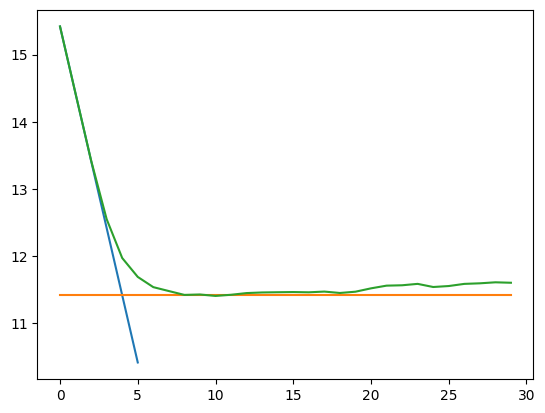

11.423528606936813 3.9946923164230093


In [29]:
# list of times with new until_r  = limit_r/2
list_of_times_nu = np.loadtxt('list_times_1Msteps_N50K_C500_a12_g4_withNEWuntilr_May1.csv')


list_val = np.array(list_of_times_nu)

border_in = np.arange(0,30, 1)

ext_time, stan_dev, climb = expected_value_constant_plus_exp(list_val)


mean_out_nu = [np.mean(list_val[list_val >= b])-b for b in border_in]
std_out = [np.std(list_val[list_val >= b]) for b in border_in]

constant = [ext_time+ climb - x for x in border_in] 
exp = [ext_time for _ in border_in]


plt.plot(border_in[:6],constant[:6])
plt.plot(border_in,exp)
plt.plot(border_in,mean_out_nu)

df = pd.DataFrame({"x": border_in, "E(T-x|T>=x)": mean_out_nu})
df.to_csv('fig3_constant_plus_exp_Model1.csv')

file_name = 'constant_plus_exp_Model1.png'
plt.savefig(file_name)


plt.show()
print(ext_time, climb)

In [67]:
# old untir_r = 5 sigma
list_of_times = np.load('list_times_1Msteps_N50K_C500_a12_g4.npy')


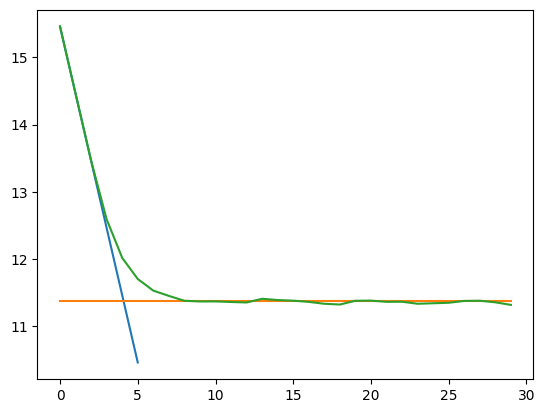

climb c: 4.091926077600183, lambda: 11.367911957755513


In [48]:

list_val = np.array(list_of_times)

border_in = np.arange(0,30, 1)

ext_time, stan_dev, climb = expected_value_constant_plus_exp(list_val)


mean_out = [np.mean(list_val[list_val >= b])-b for b in border_in]
std_out = [np.std(list_val[list_val >= b]) for b in border_in]

constant = [ext_time+ climb - x for x in border_in] 
exp = [ext_time for _ in border_in]


plt.plot(border_in[:6],constant[:6])
plt.plot(border_in,exp)
plt.plot(border_in,mean_out)

df = pd.DataFrame({"x": border_in, "E(T-x|T>=x)": mean_out})
df.to_csv('fig3_constant_plus_exp_Model1.csv')

file_name = 'constant_plus_exp_Model1.png'
plt.savefig(file_name)


plt.show()

print(f"climb c: {climb}, lambda: {ext_time}")

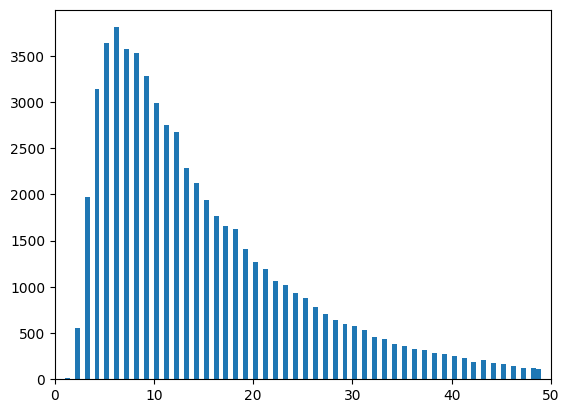

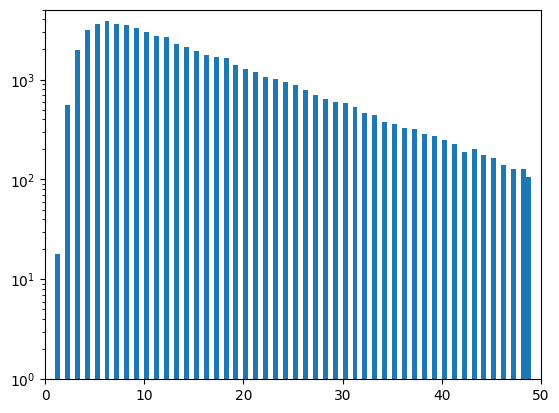

In [87]:
list_of_times_truncated = [t for t in list_of_times if t<50]

plt.xlim(0,50)
plt.hist(list_of_times_truncated, bins = 96)

plt.show()

plt.yscale('log')
plt.xlim(0,50)
plt.ylim(1,5000)
plt.hist(list_of_times_truncated, bins = 96)

plt.show()


In [49]:
starting_time = time.time()

cef_list = np.array(cuadratic_escape_function_list(0.36, 100000000))

ext_time, stan_dev, climb = expected_value_constant_plus_exp(cef_list)


np.savetxt("cuadratic_escape_function_list_036.csv", cef_list, delimiter=",")

ending_time = time.time()
print("Time elapsed :", np.around((ending_time-starting_time)/60, 2))

ext_time


Time elapsed : 1.21


11.995051582268239

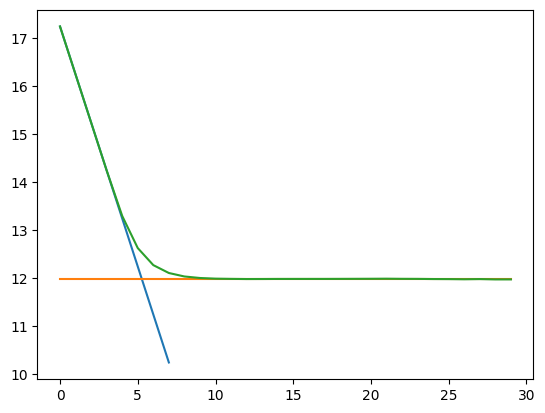

climb c: 5.2536514366697205, lambda: 11.995051582268239


In [50]:



list_val = cef_list

border_in = np.arange(0,30, 1)

ext_time, stan_dev, climb = expected_value_constant_plus_exp(list_val)


mean_out = [np.mean(list_val[list_val >= b])-b for b in border_in]
std_out = [np.std(list_val[list_val >= b]) for b in border_in]

constant = [ext_time+ climb - x for x in border_in] 
exp = [ext_time for _ in border_in]

# plt.plot(border_in,std_out)

plt.plot(border_in[:8],constant[:8])
plt.plot(border_in,exp)
plt.plot(border_in,mean_out)

df = pd.DataFrame({"x": border_in, "E(T-x|T>=x)": mean_out})
df.to_csv('fig3_constant_plus_exp_csnMC.csv')


file_name = 'constant_plus_exp_csnMC.png'
plt.savefig(file_name)


plt.show()

print(f"climb c: {climb}, lambda: {ext_time}")

In [ ]:
    np.savetxt("list_times_1Msteps_N50K_C500_a12_g4_withNEWuntilr.csv",


# Figure 4
## plotting inverse_gamma and M and K values

3.53.63333333333333333.76666666666666663.94.0333333333333334.1666666666666674.34.4333333333333344.5666666666666664.74.8333333333333334.9666666666666675.15.2333333333333335.3666666666666675.5

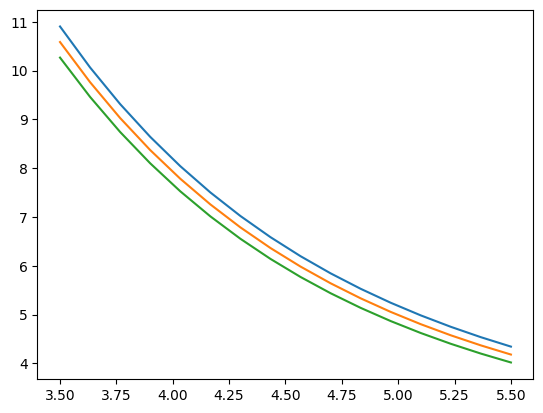

In [58]:
### Main setting
N = 50000
C = 500
alpha = 12
gamma = 4
maxW = 10


gammas = np.linspace(3.5, 5.5, 16)
M3s = []
M4s = []
M5s = []

for g in gammas:
    w_vec = w_truncated_inverse_gamma(N, g, maxW)
    K, M3 = K_and_M_time(w_vec, 10, C)
    K, M4 = K_and_M_time(w_vec, 12, C)
    K, M5 = K_and_M_time(w_vec, 15, C)
    
    print(g, end = '')
    
    M3s.append(M3) 
    M4s.append(M4) 
    M5s.append(M5) 
    
plt.plot(gammas, M3s)
plt.plot(gammas, M4s)
plt.plot(gammas, M5s)

df = pd.DataFrame({"gammas": gammas, "M3s": M3s,  "M4s": M4s,  "M5s": M5s})
df.to_csv('fig4_M_alpha_delta.csv')



file_name = 'fig4_M_alpha_delta.png'
plt.savefig(file_name)

plt.show()

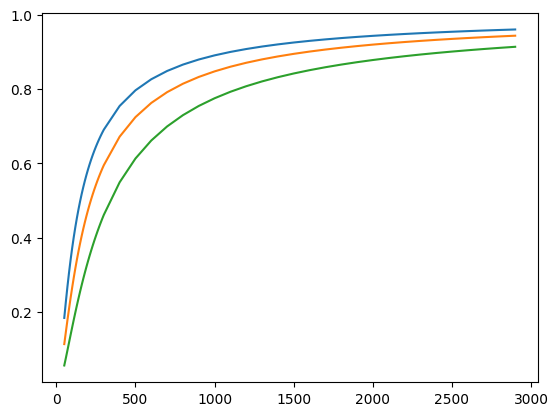

In [59]:
### Main setting
N = 50000
C = 500
alpha = 12
gamma = 4
maxW = 10


w_vec = w_truncated_inverse_gamma(N, gamma, maxW)
Cs = np.concatenate((np.arange(50,300,10) ,np.arange(300, 3000, 100)))


df = pd.DataFrame({"C": Cs})


# for alpha in [10,20,30,40]:
for alpha in [10,12,15]:
    Ks = []
    for C in Cs:
        K, M = K_and_M_time(w_vec, alpha, C)    
        Ks.append(K)
    plt.plot(Cs, Ks)
    df['Ks'+str(alpha)] = Ks


df.to_csv('fig4_K_alpha_delta_C_long.csv')


file_name = 'fig4_K_alpha_delta_C_long.png'
plt.savefig(file_name)


plt.show()

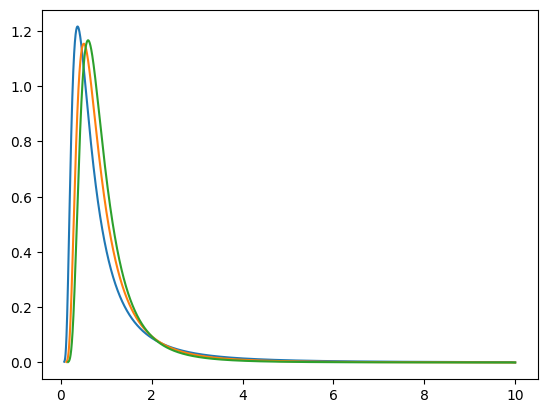

In [56]:
### Main setting
N = 50000
C = 500
alpha = 12
gamma = 4
maxW = 10



for gamma in [3,4,5]:
    w_vec = w_truncated_inverse_gamma(N, gamma, maxW)
    density = [1/(N*(w_vec[i+1] - w_vec[i])) for i in range(N-1)] + [0]
#     plt.yscale('log')
#     plt.xscale('log')
    plt.plot(list(w_vec[:-1])+[10], density)
    
file_name = 'fig4_inv_gammas.png'
plt.savefig(file_name)


plt.show()

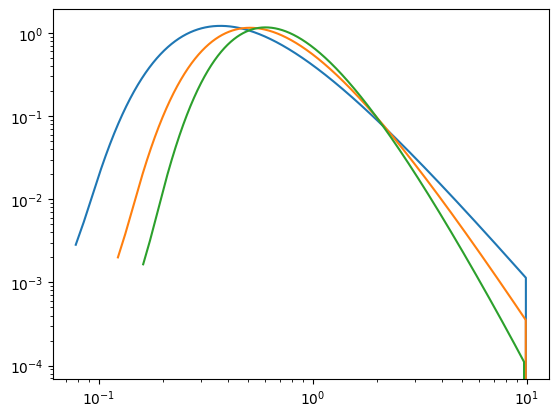

In [7]:
### Main setting
N = 50000
C = 500
alpha = 12
gamma = 4
maxW = 10

df = pd.DataFrame()


for gamma in [3,4,5]:
    w_vec = w_truncated_inverse_gamma(N, gamma, maxW)
    df["w"+str(gamma)] = list(w_vec[:-1])+[10]
    density = [1/(N*(w_vec[i+1] - w_vec[i])) for i in range(N-1)] + [0]
    plt.yscale('log')
    plt.xscale('log')
    df["gamma"+str(gamma)] = density
    plt.plot(df["w"+str(gamma)], df["gamma"+str(gamma)])
    
    
df.to_csv('fig4_inv_gamma.csv')

file_name = 'inv_gamma_loglog.png'
plt.savefig(file_name)


plt.show()

array([2. , 1.9, 1.8, 1.7, 1.6, 1.5, 1.4, 1.3, 1.2, 1.1, 1. , 0.9, 0.8,
       0.7, 0.6, 0.5, 0.4, 0.3, 0.2, 0.1])

## For 4-way paper

In [57]:
N = 500000
C = 300
gamma = 3
maxW = 40

mod = init_Kuramoto_invGamma_file(N, C, gamma, maxW=maxW, verbose = True)   # initiate setting for the model


Generating model from edge-list. N=500000, C=300, g=3


Figure 1

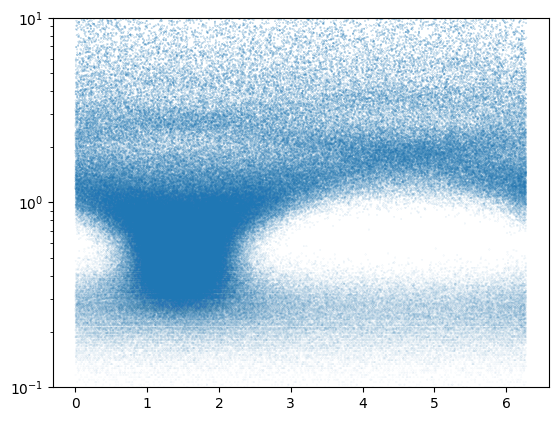

2.0


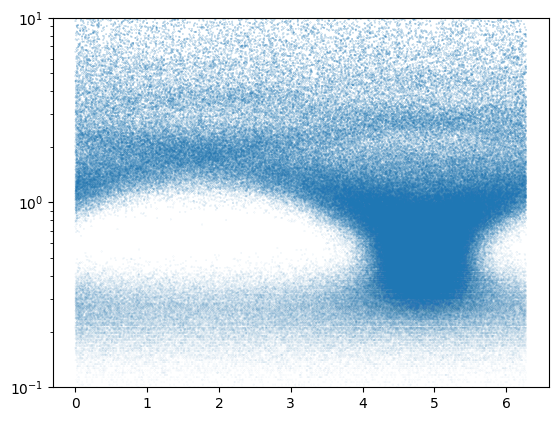

1.9


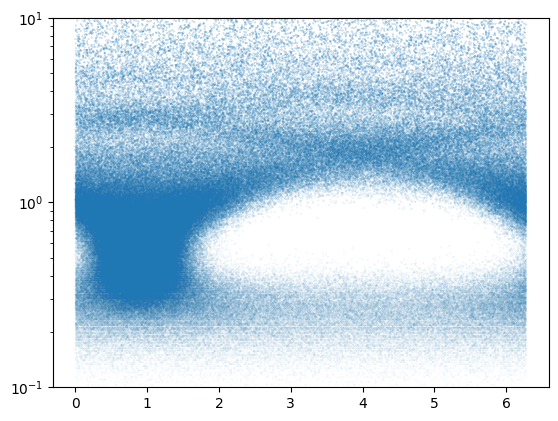

1.8


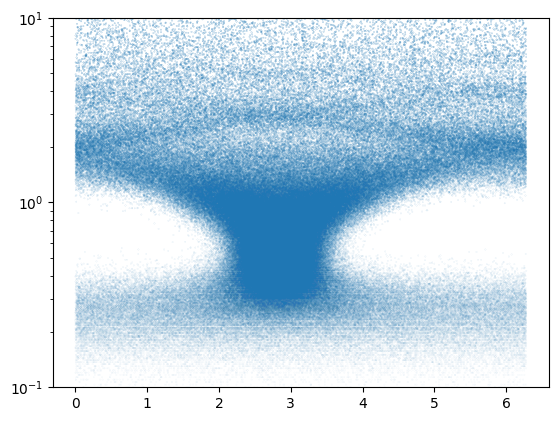

1.7


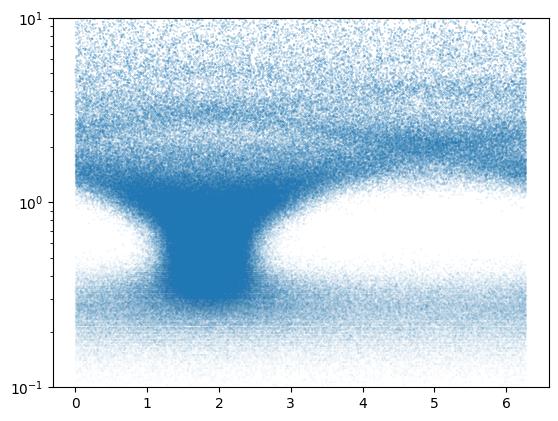

1.6


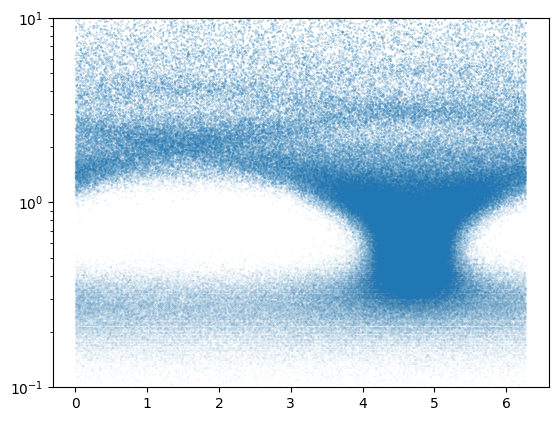

1.5


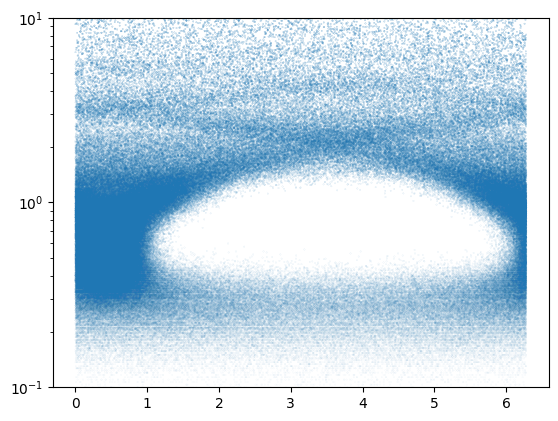

1.4


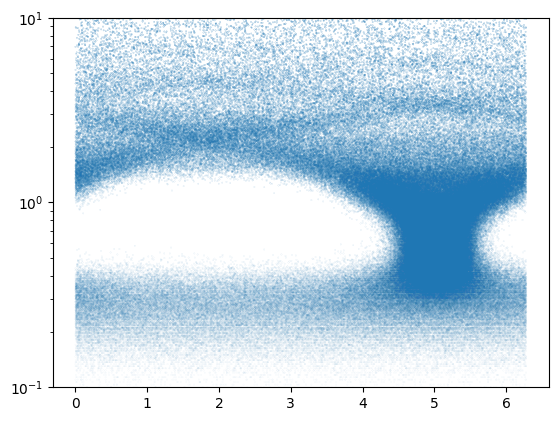

1.2999999999999998


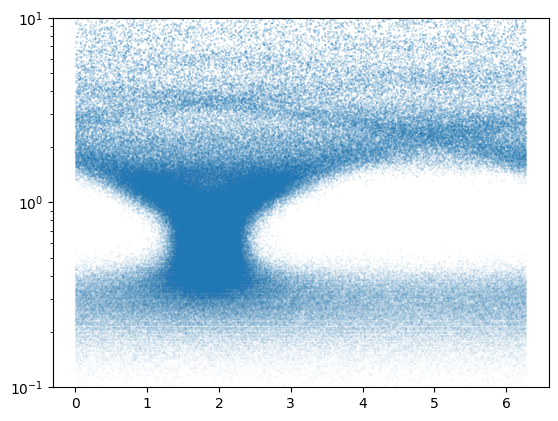

1.2


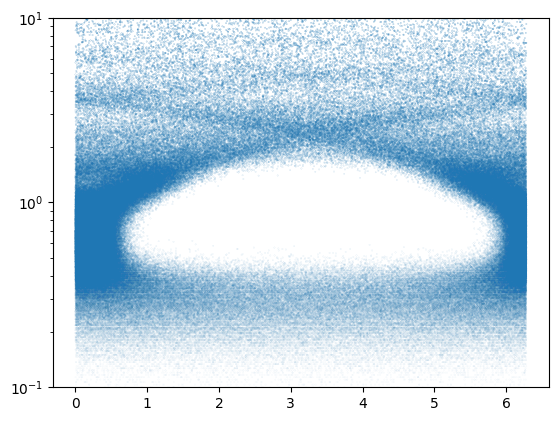

1.1


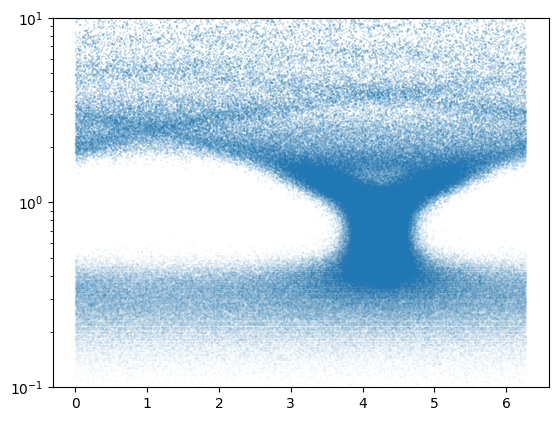

1.0


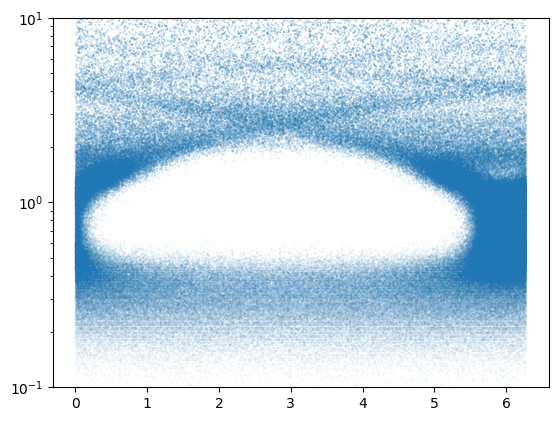

0.8999999999999999


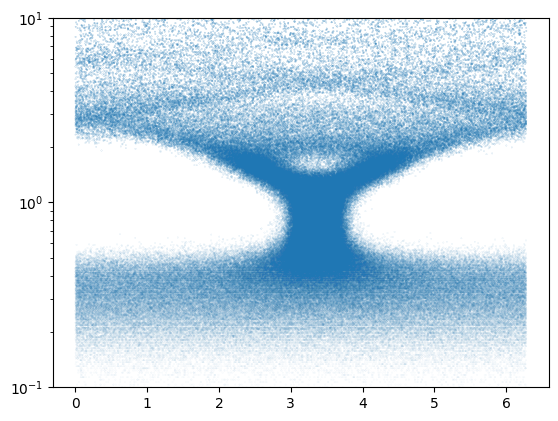

0.7999999999999998


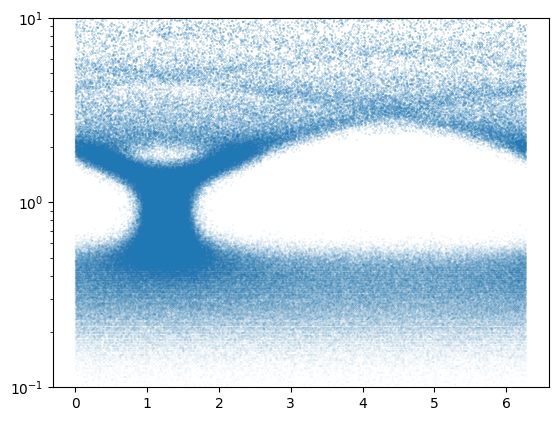

0.7


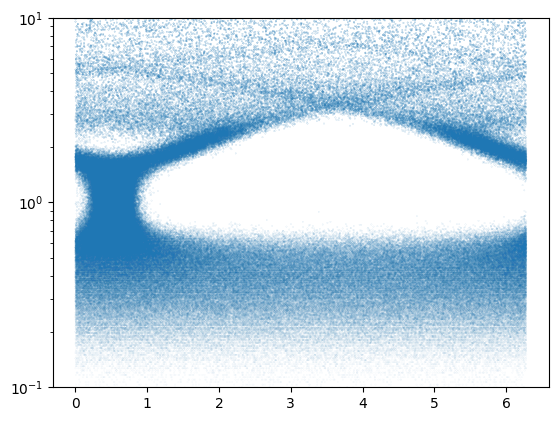

0.5999999999999999


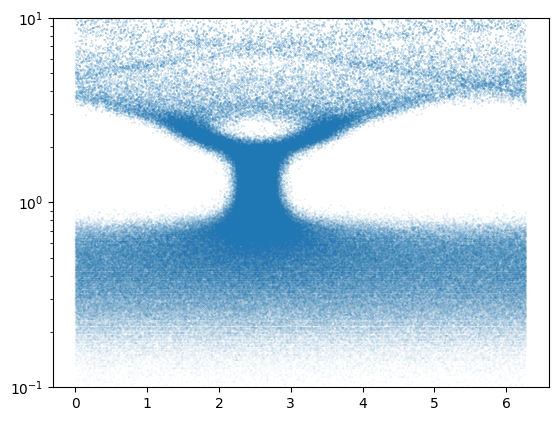

0.5


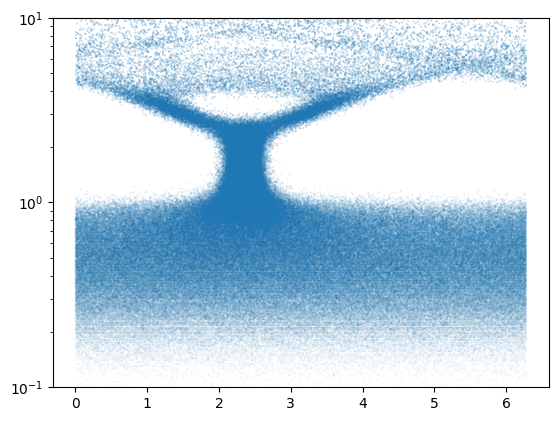

0.3999999999999999


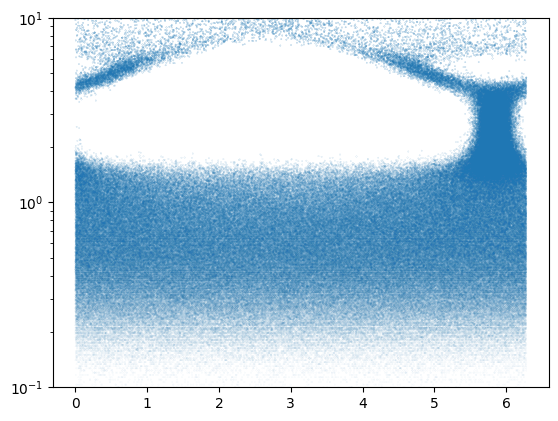

0.2999999999999998


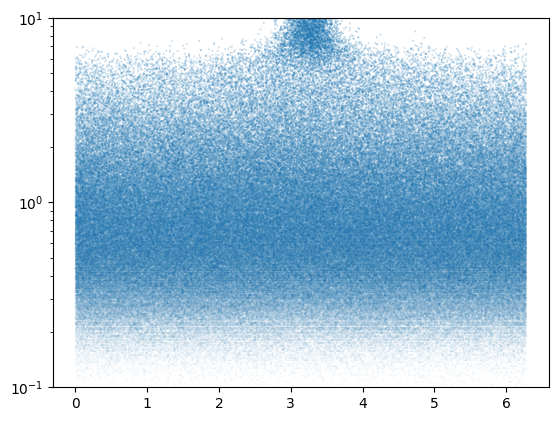

0.19999999999999996


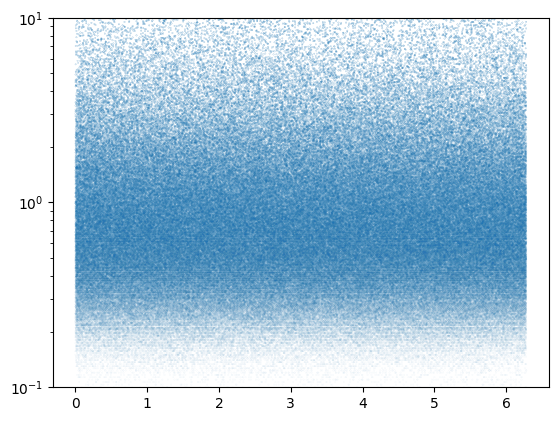

0.09999999999999987


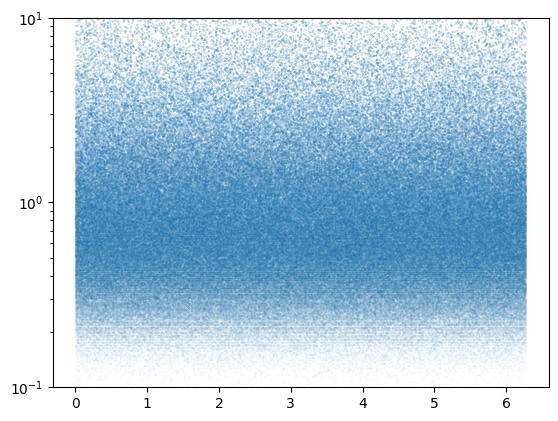

0.0


In [58]:


mod.set_alpha(4*np.pi)
mod.estimated_expected_time()
force_sync(mod)



al_s = np.linspace(2,0,21)

states_df = pd.DataFrame({"w_vector": mod.w_vector})

for al in al_s:

    if al < 0.6:
       num_steps = 200
    else:
        num_steps = 20

    for epsilon in np.linspace(1,0,num_steps):
        alpha = (al+epsilon) * 2 * np.pi
        mod.set_alpha(alpha)
        mod.one_step()

    for _ in range(num_steps):
        mod.one_step()



        
    plt.yscale('log')
    plt.ylim(0.1,10)
    plt.scatter(mod.th_vector, mod.w_vector, s= (mod.w_vector)/500)
    plt.show()

    print(al)

    states_df['theta'+str(al)] = mod.th_vector / (2 * np.pi)


states_df.to_csv("z_values_4way_paper_.csv")
    


Figure 1 for different dynamics

In [5]:
N = 500000
C = 300
gamma = 3
maxW = 40

mod = init_Kuramoto_invGamma_file_Variation(N, C, gamma, maxW=maxW, verbose = True)   # initiate setting for the model


Generating model from edge-list. N=500000, C=300, g=3


'0.25'

-------------------------------------
-------------------------------------
-------------------------------------
-------------------------------------
-------------------------------------
-------------------------------------
-------------------------------------
-------------------------------------
-------------------------------------
-------------------------------------
-------------------------------------
1.0 0


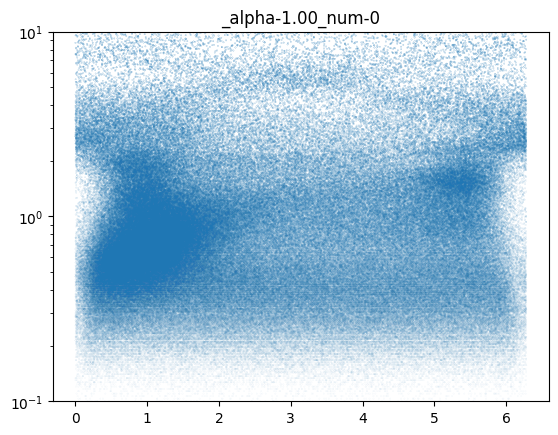

1.0 1


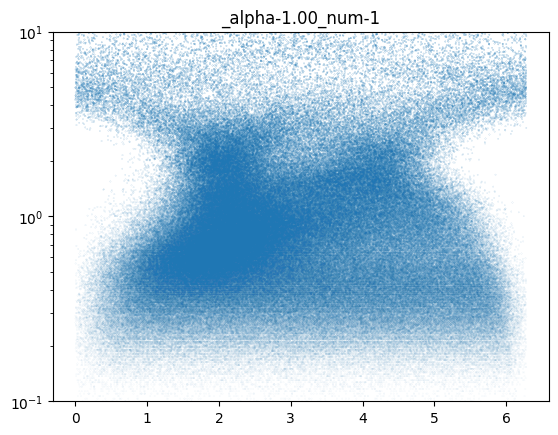

1.0 2


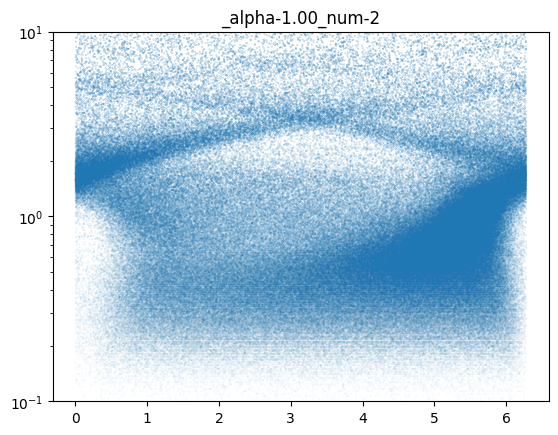

1.0 3


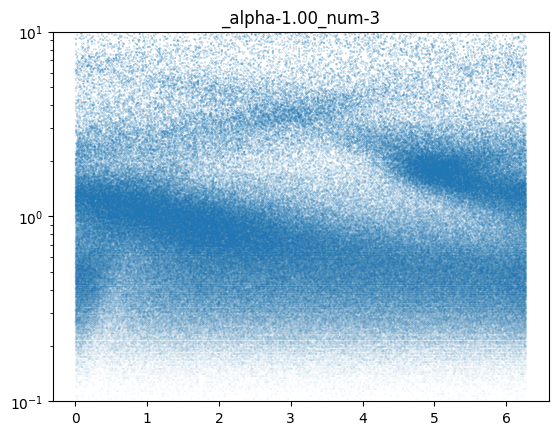

1.0 4


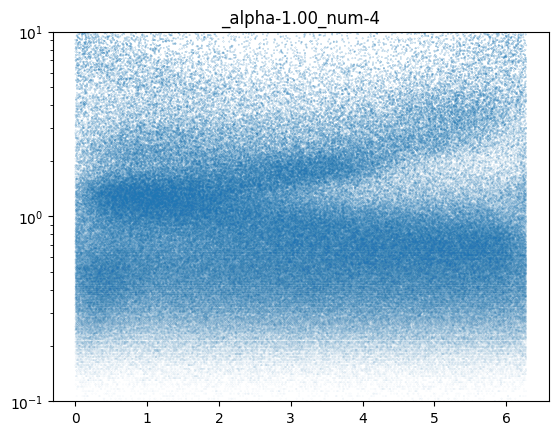

1.0 5


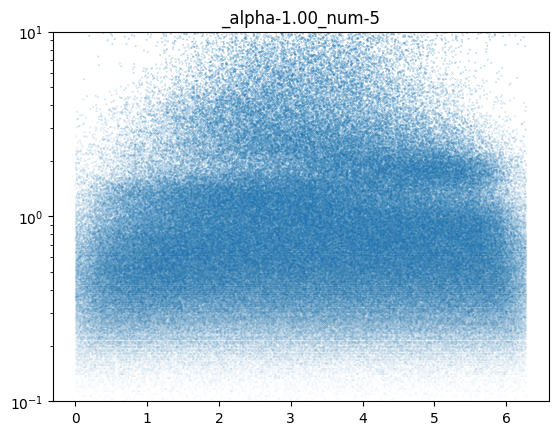

1.0 6


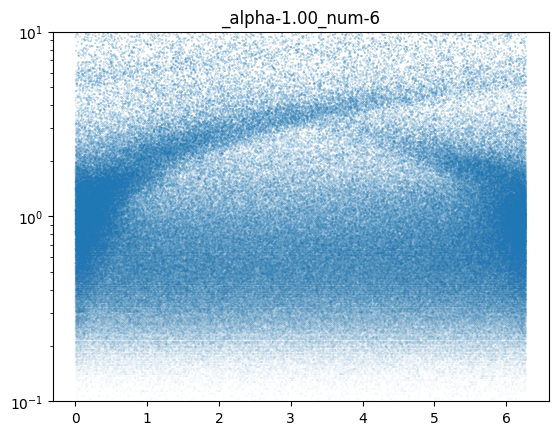

1.0 7


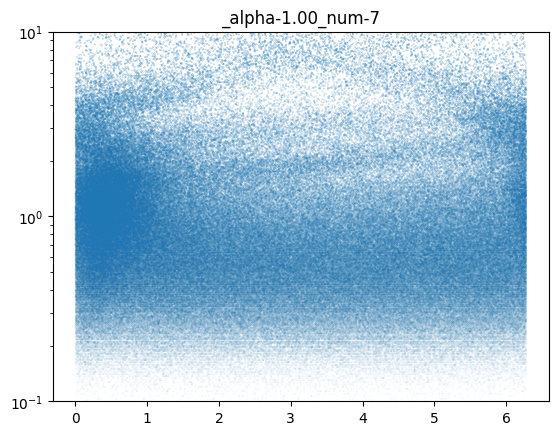

1.0 8


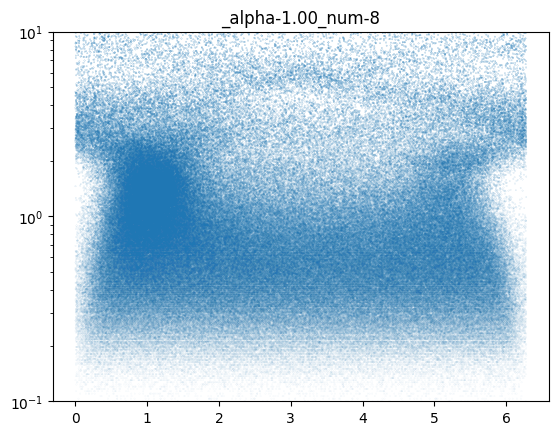

1.0 9


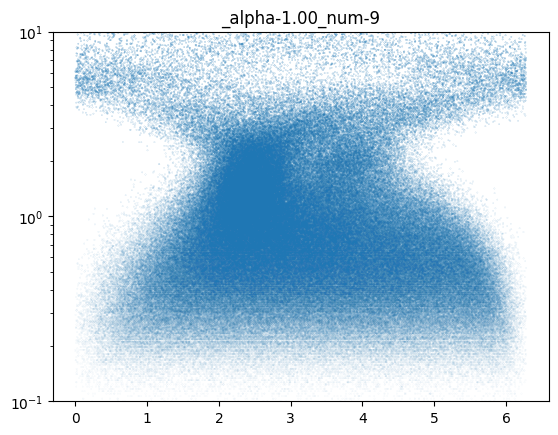

-------------------------------------
-------------------------------------
-------------------------------------
0.7 0


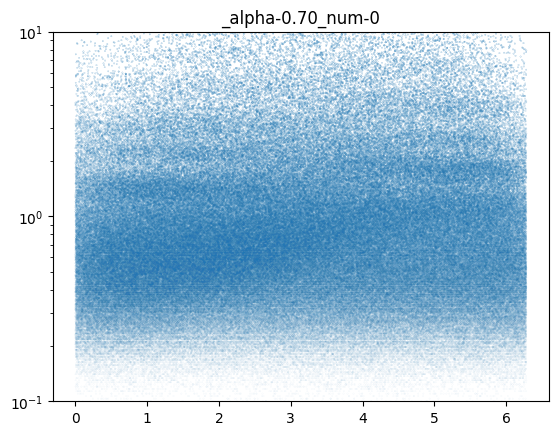

0.7 1


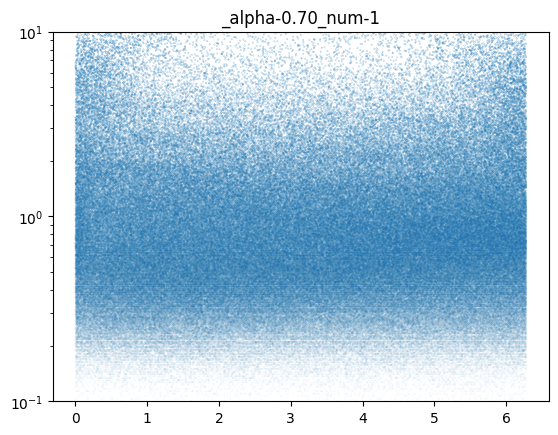

0.7 2


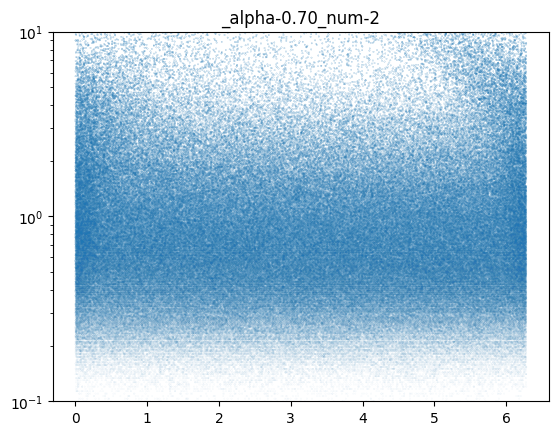

0.7 3


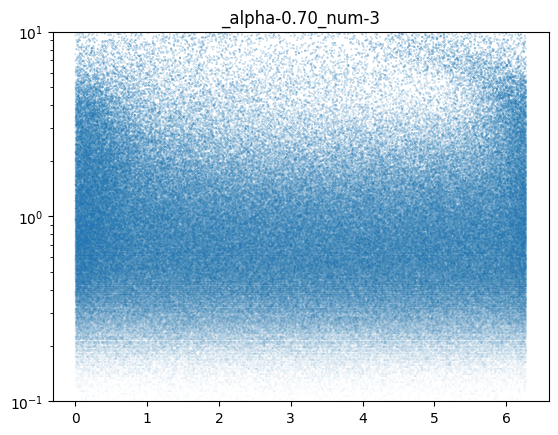

0.7 4


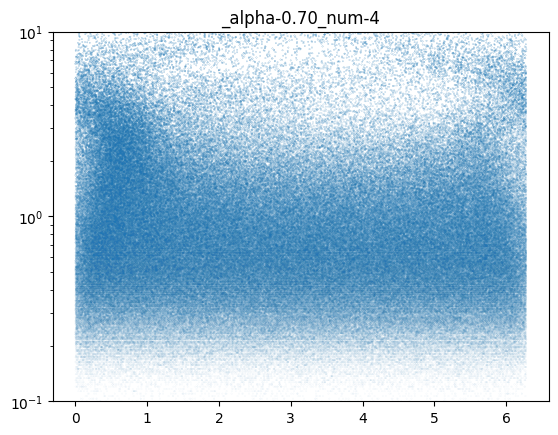

0.7 5


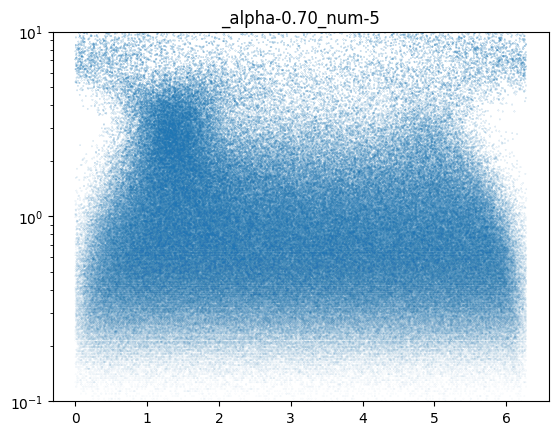

0.7 6


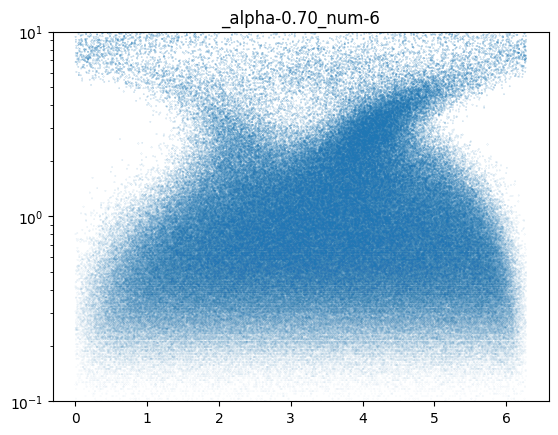

0.7 7


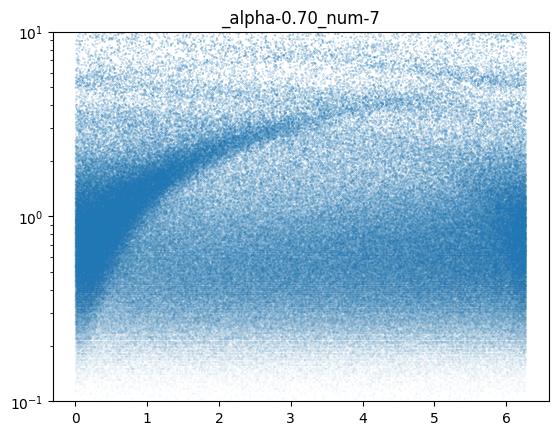

0.7 8


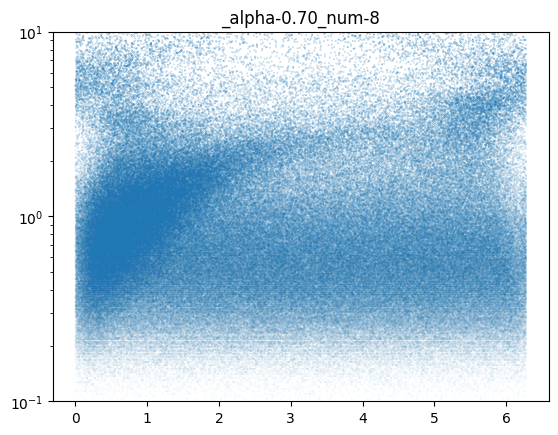

0.7 9


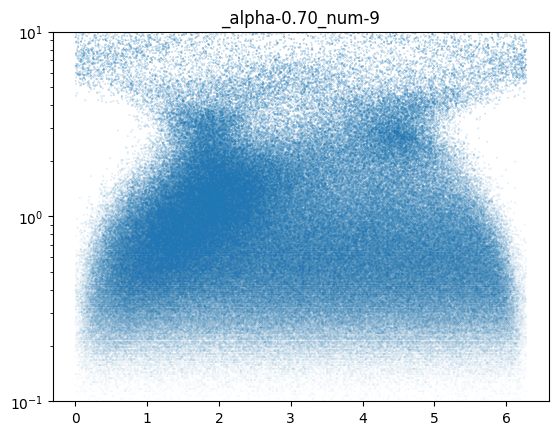

-------------------------------------
-------------------------------------
0.5 0


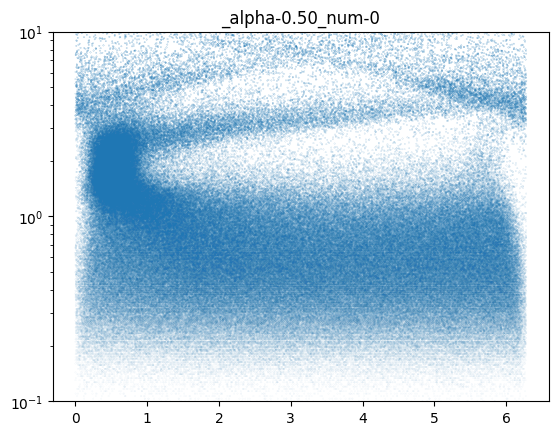

0.5 1


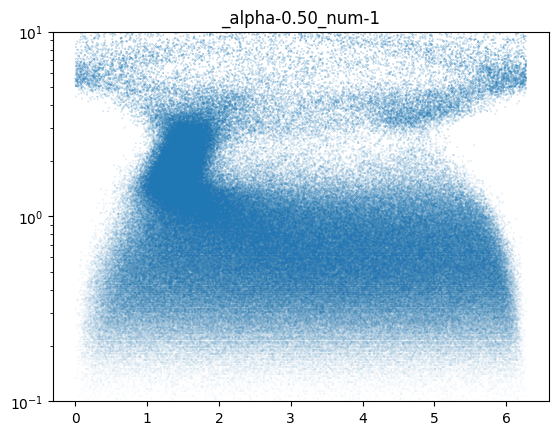

0.5 2


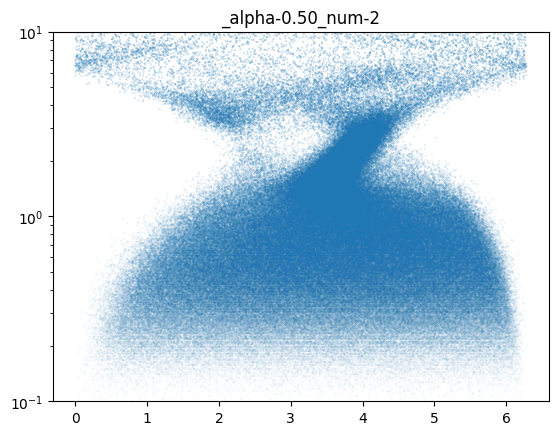

0.5 3


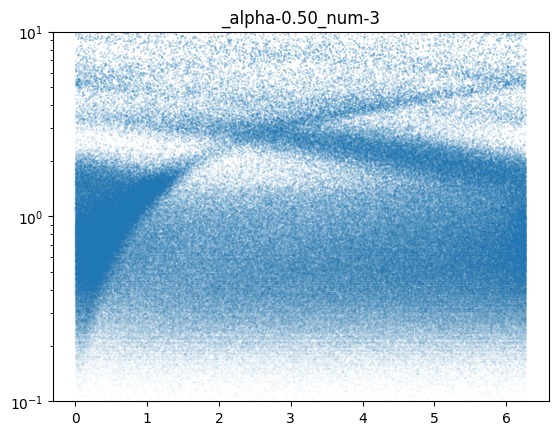

0.5 4


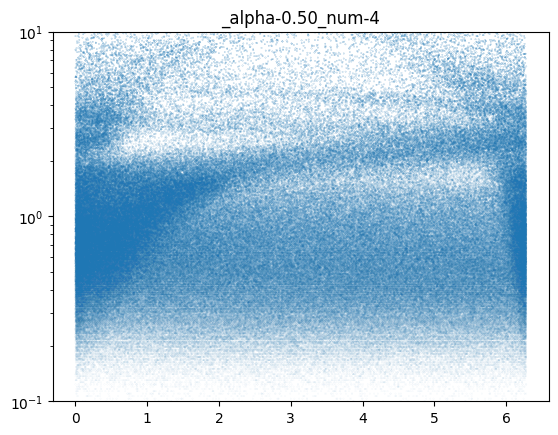

0.5 5


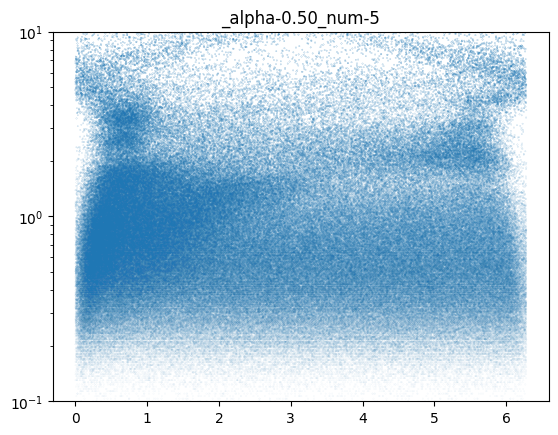

0.5 6


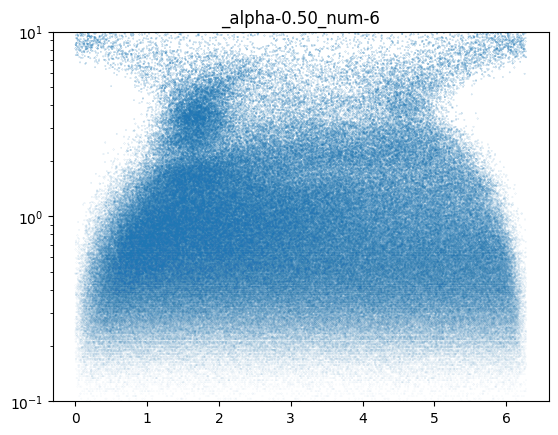

0.5 7


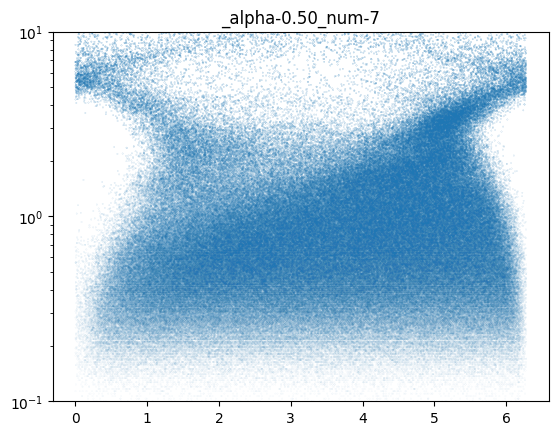

0.5 8


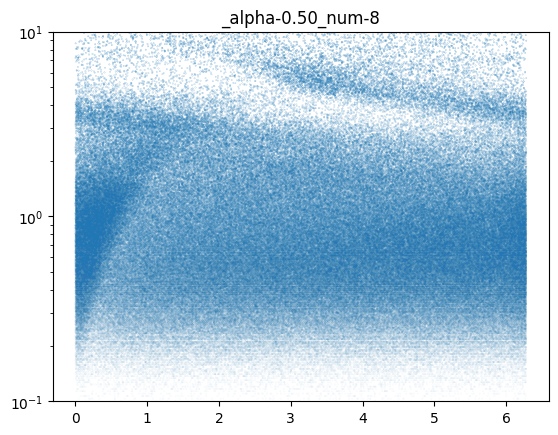

0.5 9


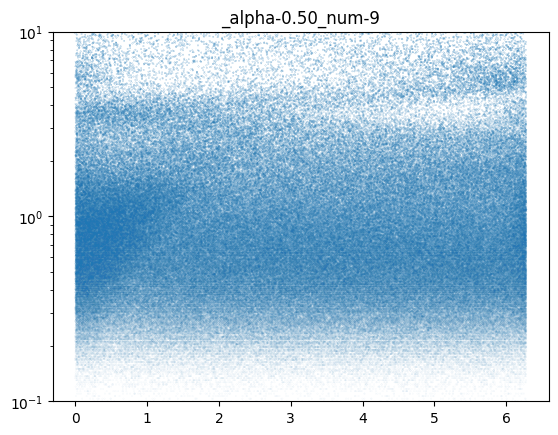

-------------------------------------
-------------------------------------
0.3 0


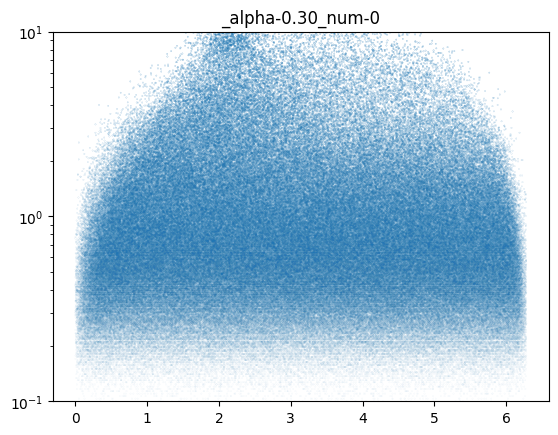

0.3 1


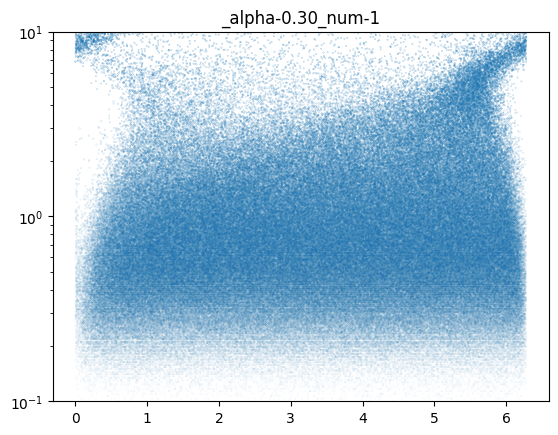

0.3 2


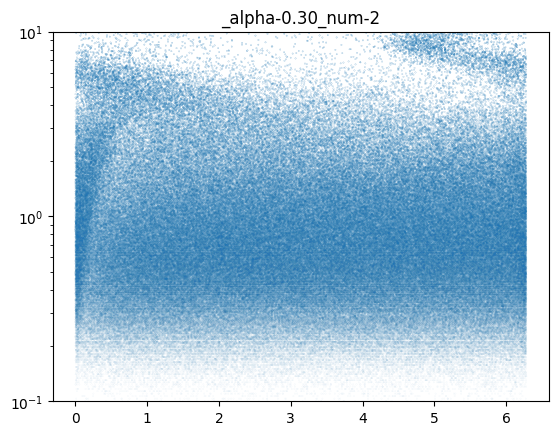

0.3 3


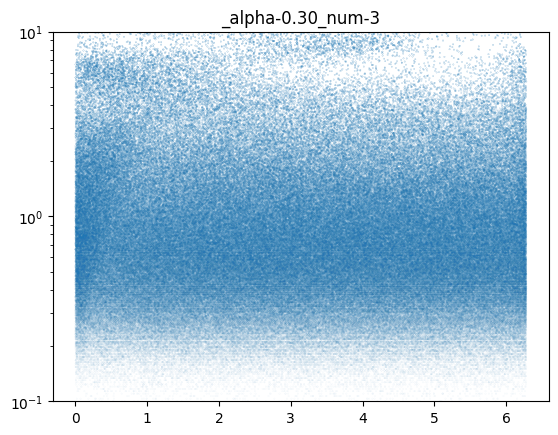

0.3 4


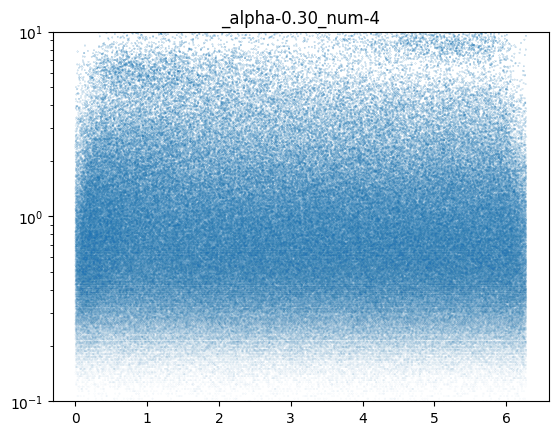

0.3 5


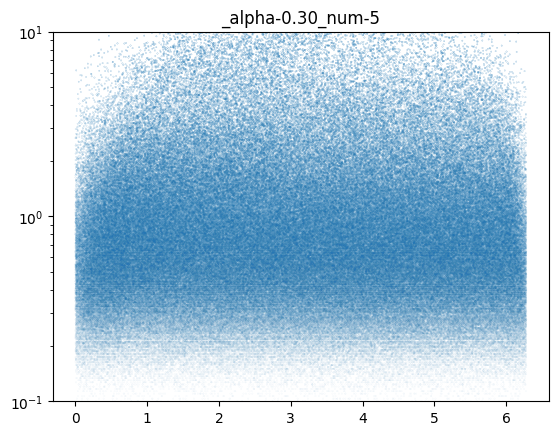

0.3 6


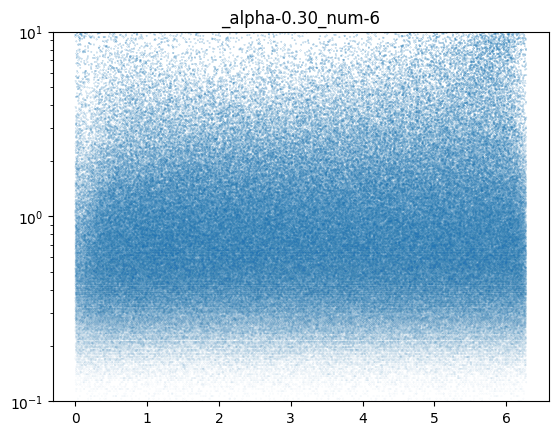

0.3 7


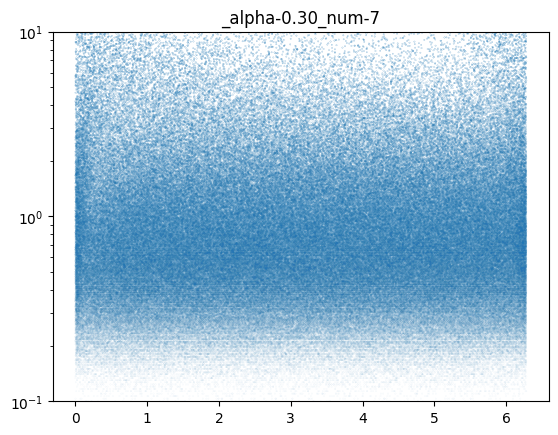

0.3 8


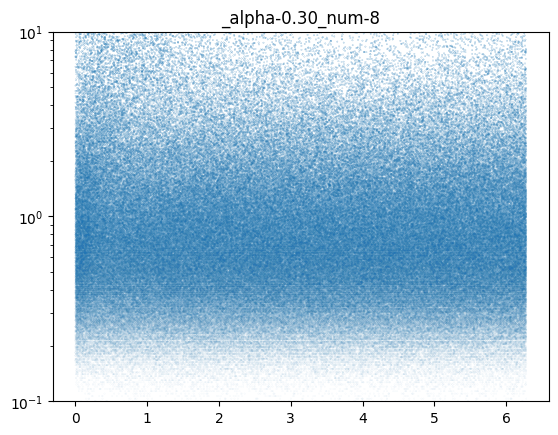

0.3 9


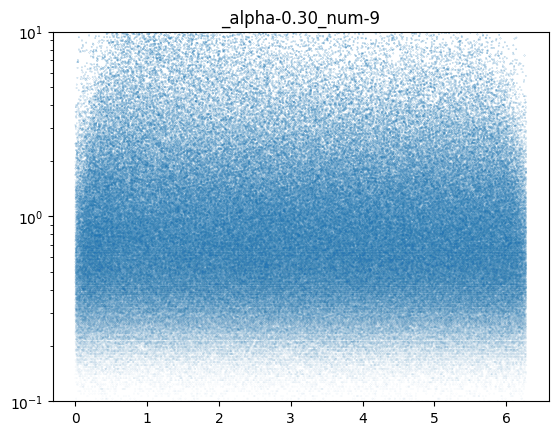

-------------------------------------
-------------------------------------
0.1 0


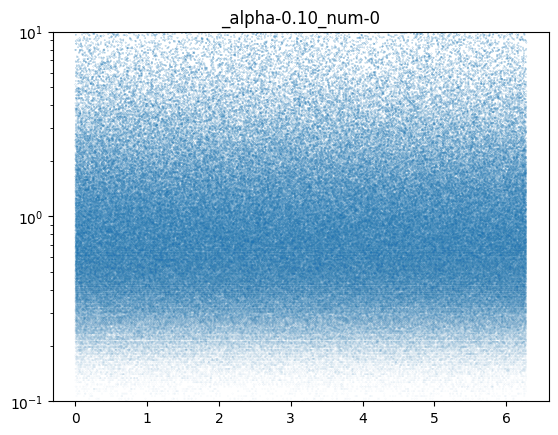

0.1 1


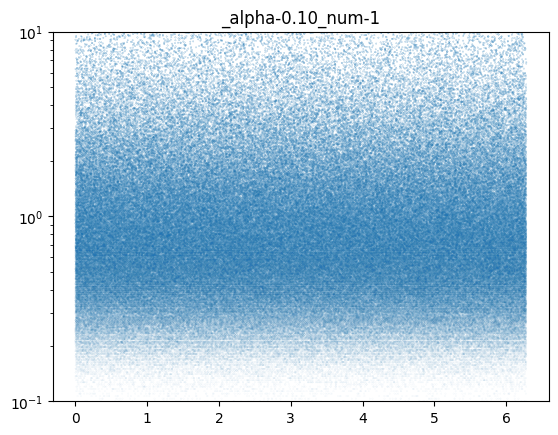

0.1 2


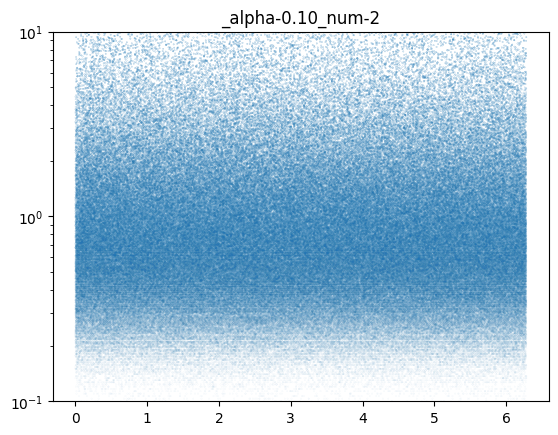

0.1 3


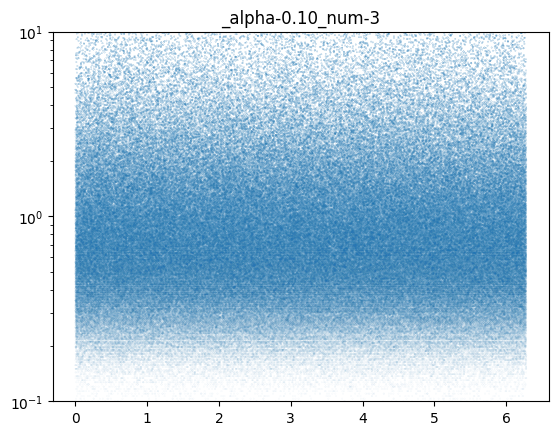

0.1 4


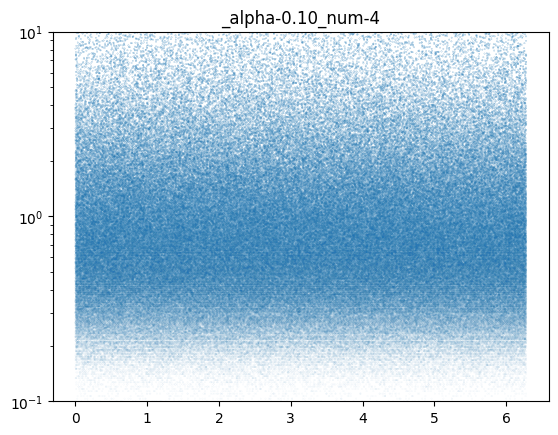

0.1 5


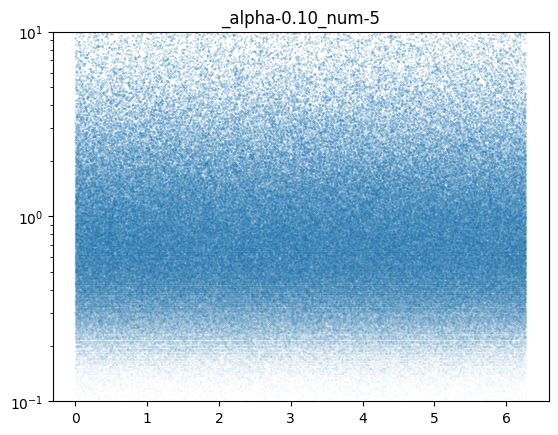

0.1 6


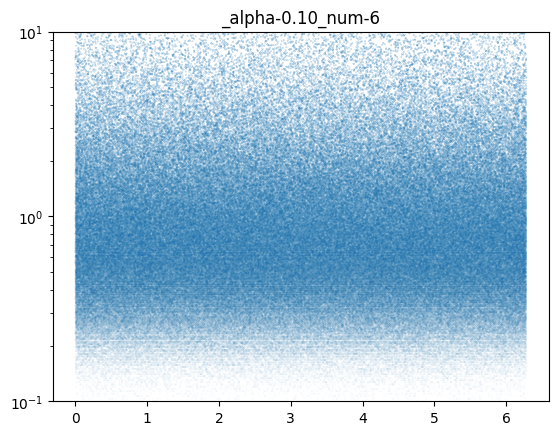

0.1 7


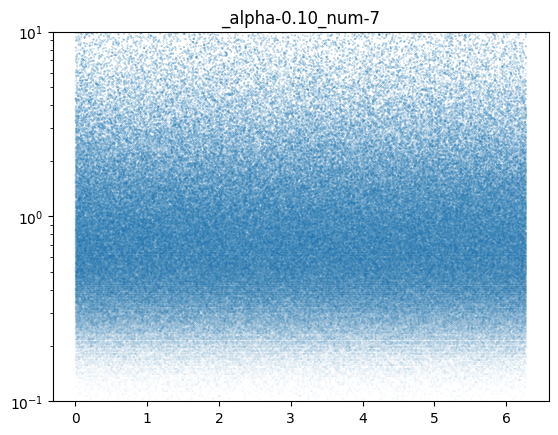

0.1 8


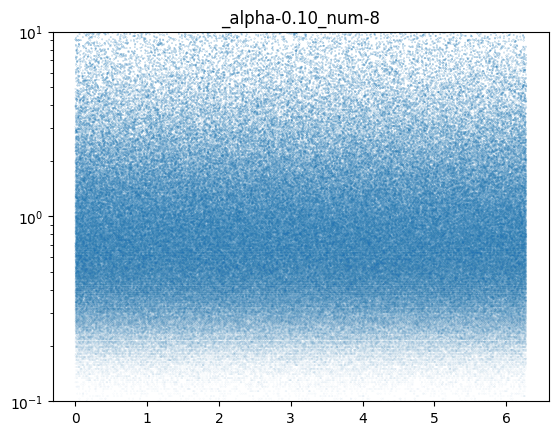

0.1 9


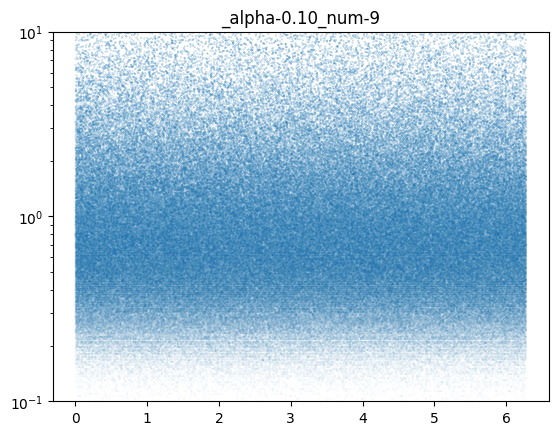

In [14]:



mod.set_alpha(4*np.pi)
mod.estimated_expected_time()
force_sync(mod)


values_to_print = [0.1, 0.3, 0.5, 0.7, 1.0]

num_of_snapshots = 10

al_s = [i/10 for i in range(20,0,-1)]

states_df = pd.DataFrame({"w_vector": mod.w_vector})

for al in al_s:

    num_steps = 200

    # if al < 1.3:
    #    num_steps = 200
    # else:
    #     num_steps = 20

    for epsilon in np.linspace(1,0,num_steps):
        alpha = (al+epsilon) * 2 * np.pi
        mod.set_alpha(alpha)
        mod.one_step()

    for i in range(num_steps):
        mod.one_step()

    print('-------------------------------------')
    
    if al in values_to_print:
        for i in range(num_of_snapshots):
            print(al, i)
            
            mod.one_step()
            states_df['theta'+ "_alpha-" + f"{al:.2f}" + '_num-' + str(i) ] = mod.th_vector / (2 * np.pi)

            plt.yscale('log')
            plt.ylim(0.1,10)
            plt.scatter(mod.th_vector, mod.w_vector, s= (mod.w_vector)/500)
            plt.title("_alpha-" + f"{al:.2f}" + '_num-' + str(i))
            plt.show()



states_df.to_csv("z_values_4way_paper_.csv")
    


In [1]:
2+2

4

In [8]:
states_df.columns

Index(['w_vector', 'theta_alpha-2.0_num-0', 'theta_alpha-2.0_num-1',
       'theta_alpha-2.0_num-2', 'theta_alpha-2.0_num-3',
       'theta_alpha-2.0_num-4', 'theta_alpha-1.9_num-0',
       'theta_alpha-1.9_num-1', 'theta_alpha-1.9_num-2',
       'theta_alpha-1.9_num-3',
       ...
       'theta_alpha-0.09999999999999987_num-0',
       'theta_alpha-0.09999999999999987_num-1',
       'theta_alpha-0.09999999999999987_num-2',
       'theta_alpha-0.09999999999999987_num-3',
       'theta_alpha-0.09999999999999987_num-4', 'theta_alpha-0.0_num-0',
       'theta_alpha-0.0_num-1', 'theta_alpha-0.0_num-2',
       'theta_alpha-0.0_num-3', 'theta_alpha-0.0_num-4'],
      dtype='object', length=106)

In [ ]:
N = 500000
C = 300
gamma = 3
maxW = 40

mod = init_Kuramoto_invGamma_file(N, C, gamma, maxW=maxW, verbose = True)   # initiate setting for the model


In [46]:
N = 50000
C = 1000
gamma = 3
maxW = 10

# w_vec = w_truncated_inverse_gamma(N, gamma, maxW)
mod = init_Kuramoto_invGamma_file(N, C, gamma, maxW=maxW, verbose = True)



Generating model from edge-list. N=50000, C=1000, g=3


1.8185223456471196

In [54]:
mod.set_alpha(2*np.pi)
mod.estimated_expected_time()


140.2078853046595

In [1]:


# mod.set_uniform()

# splits = 10000
# Ni = 10000

# steps = (N-Ni)//splits

# states_df = pd.DataFrame({"w_vector": mod.w_vector})

# for ti in range(500):
#     mod.one_step()    
        
#     states_df['theta'+str(ti)] = mod.th_vector
    
#     plt.figure(figsize=(2,3)) 
#     plt.yscale('log')
#     plt.ylim(0.1,10)
#     plt.scatter(mod.th_vector, mod.w_vector, s= (mod.w_vector)/500)

#     file_name = '4W_paper_scatter_points_time_' + str(ti)+ '.png'
#     plt.savefig(file_name)
#     plt.show()

    
# states_df.to_csv("4W_state_by_steps.csv")

/var/folders/ld/myyy3ll5499__8dh61ly1gz40000gn/T/ipykernel_7376/2469360189.py:13: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  plt.scatter(df3.MC_coef_inverse[df3.N==30000]**2, (df3.sim_escape[df3.N==30000]), c =(0,0.7,0.3), s = 2)      #['#1f77b4']
/var/folders/ld/myyy3ll5499__8dh61ly1gz40000gn/T/ipykernel_7376/2469360189.py:14: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  plt.scatter(df3.MC_coef_inverse[df3.N==100000]**2

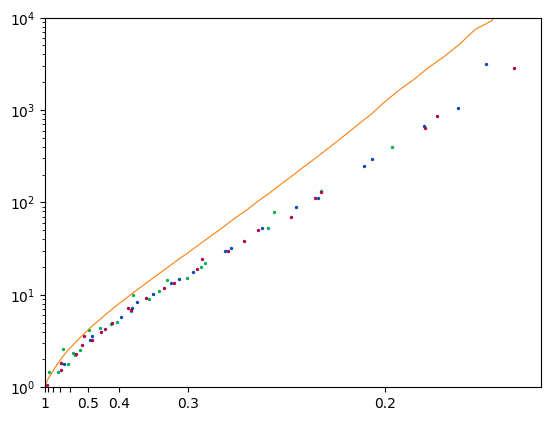

In [7]:
escape_df = pd.read_csv('escape_time_values.csv', index_col = 0)

df3 = pd.read_csv('data_Model1_100000.csv', index_col=0)
df3['MC_coef_inverse'] = 1/(df3.k_coeficient*df3.sigma)


max_x = 6
plt.xlim(1,(max_x)**2)
plt.ylim(1,10000)
plt.yscale('log')


plt.scatter(df3.MC_coef_inverse[df3.N==30000]**2, (df3.sim_escape[df3.N==30000]), c =(0,0.7,0.3), s = 2)      #['#1f77b4']
plt.scatter(df3.MC_coef_inverse[df3.N==100000]**2, (df3.sim_escape[df3.N==100000]), c =(0,0.3,0.7), s = 2)   #['#d62728']
plt.scatter(df3.MC_coef_inverse[df3.N==50000]**2, (df3.sim_escape[df3.N==50000]), c = (.7,0,0.3), s = 2)     #['#9467bd']


# Transform the y-values with a square root function for a quadratic scale
x_transformed = (escape_df['sigma_in'])**2


plt.plot(x_transformed, escape_df['escape_time'], c ='#ff7f0e', linewidth = 0.8)


# Customize the y-axis tick labels
x_ticks = np.array([1, 0.9,0.8, 0.7, 0.6, 0.5 ,0.4, 0.3, 0.2])
x_ticks_lab = [1, '', ' ','', ' ', 0.5 ,0.4, 0.3, 0.2]
plt.xticks((1/x_ticks)**2, x_ticks_lab)

file_name = 'MC_coef_vs_sim_escape_100000_scaled.png'
plt.savefig(file_name)

plt.show()

In [9]:
df3.columns

Index(['N', 'alpha', 'C', 'gamma', 'maxW', 'sim_escape',
       'estimated_spark_time', 'k_coeficient', 'coefLR', 'sigma', 'rss',
       'kbeta', 'M2', 'M3', 'preciscion_esc', 'limit_r_forced', 'std_r_forced',
       'number_of_iterates', 'climb', 'sbeta', 'graph_filename',
       'MC_coef_inverse'],
      dtype='object')

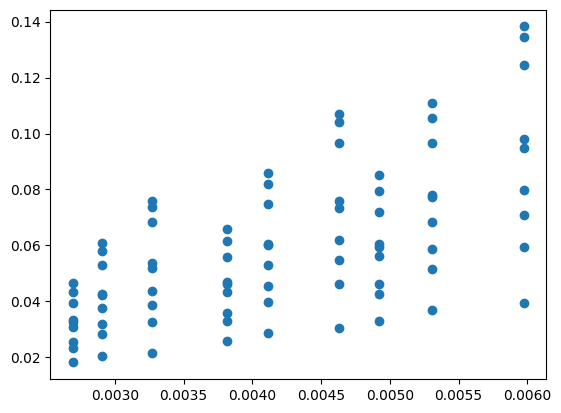

In [22]:
plt.scatter(df3.sigma, df3.alpha * df3.sbeta/(2*df3.N)**0.5)

In [33]:
# MODIFYING TRYING TO INCLUDE S_BETA

df3['s_beta_final'] = (df3.alpha/2) * df3.sbeta/(2*df3.N)**0.5
df3['s_beta_final'].mean(), df3['s_beta_final'].max()

(0.029514581231607776, 0.06913383198438632)

/var/folders/ld/myyy3ll5499__8dh61ly1gz40000gn/T/ipykernel_7376/3490845955.py:9: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  plt.scatter(df3.MC_coef_inverse_S**2, (df3.sim_escape), c =(0,0.7,0.3), s = 2)      #['#1f77b4']
/var/folders/ld/myyy3ll5499__8dh61ly1gz40000gn/T/ipykernel_7376/3490845955.py:11: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  plt.scatter(df3.MC_coef_inverse**2, (df3.sim_escape), c =(1,0,0.3), s = 2)  

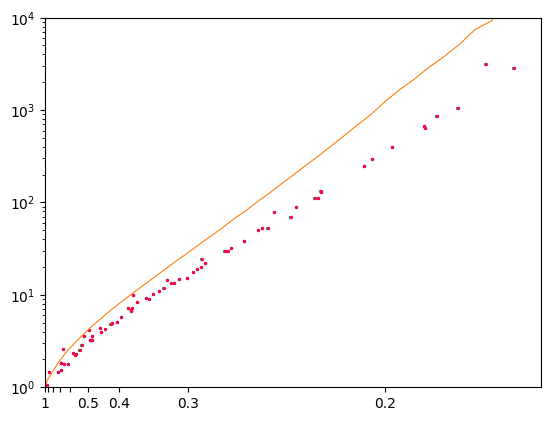

In [27]:

max_x = 6
plt.xlim(1,(max_x)**2)
plt.ylim(1,10000)
plt.yscale('log')

df3['MC_coef_inverse_S'] = 1/(df3.k_coeficient*df3.sigma*(1+2*df3['s_beta_final']**2)**0.5)


plt.scatter(df3.MC_coef_inverse_S**2, (df3.sim_escape), c =(0,0.7,0.3), s = 2)      #['#1f77b4']

plt.scatter(df3.MC_coef_inverse**2, (df3.sim_escape), c =(1,0,0.3), s = 2)      #['#1f77b4']


# Transform the y-values with a square root function for a quadratic scale
x_transformed = (escape_df['sigma_in'])**2


plt.plot(x_transformed, escape_df['escape_time'], c ='#ff7f0e', linewidth = 0.8)


# Customize the y-axis tick labels
x_ticks = np.array([1, 0.9,0.8, 0.7, 0.6, 0.5 ,0.4, 0.3, 0.2])
x_ticks_lab = [1, '', ' ','', ' ', 0.5 ,0.4, 0.3, 0.2]
plt.xticks((1/x_ticks)**2, x_ticks_lab)


plt.show()

In [ ]:
Ns = [30000]
Cs = [300]
alphas = list(range(31,41,2))
gammas = [3, 4, 5]
    
save_input_file("input_file.txt", Ns, Cs, alphas, gammas)

In [66]:
Ns = [30000, 50000, 100000]
Cs = [300, 500, 1000]
alphas = [10,12,15]
gammas = [3, 4, 5]
    
save_input_file("input_file.txt", Ns, Cs, alphas, gammas)

In [65]:
Ns = [5000,10000,20000,50000]
Cs = [100,200,300,400]
alphas = [10,12,15]
gammas = [3, 4, 5]
    
save_input_file("input_file.txt", Ns, Cs, alphas, gammas)

In [64]:
Ns = [10000]
Cs = [100]
alphas = list(range(31,41,2))
gammas = [3, 4, 5]
    
save_input_file("input_file.txt", Ns, Cs, alphas, gammas)

In [280]:
%run ./Kuramoto.ipynb

# Values of K and M(delta)

3.53.63333333333333333.76666666666666663.94.0333333333333334.1666666666666674.34.4333333333333344.5666666666666664.74.8333333333333334.9666666666666675.15.2333333333333335.3666666666666675.5

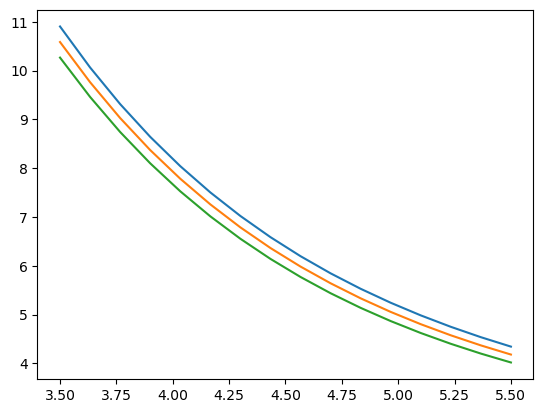

In [337]:
### Main setting
N = 50000
C = 500
alpha = 12
gamma = 4
maxW = 10


gammas = np.linspace(3.5, 5.5, 16)
M3s = []
M4s = []
M5s = []

for g in gammas:
    w_vec = w_truncated_inverse_gamma(N, g, maxW)
    K, M3 = K_and_M_time(w_vec, 10, C)
    K, M4 = K_and_M_time(w_vec, 12, C)
    K, M5 = K_and_M_time(w_vec, 15, C)
    
    print(g, end = '')
    
    M3s.append(M3) 
    M4s.append(M4) 
    M5s.append(M5) 
    
plt.plot(gammas, M3s)
plt.plot(gammas, M4s)
plt.plot(gammas, M5s)

df = pd.DataFrame({"gammas": gammas, "M3s": M3s,  "M4s": M4s,  "M4s": M4s})
df.to_csv('fi4_M_alpha_delta.csv')



file_name = 'M_alpha_delta.png'
plt.savefig(file_name)

plt.show()

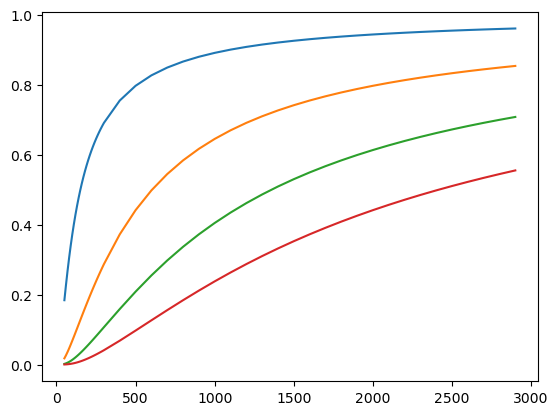

In [340]:
### Main setting
N = 50000
C = 500
alpha = 12
gamma = 4
maxW = 10


w_vec = w_truncated_inverse_gamma(N, gamma, maxW)
Cs = np.concatenate((np.arange(50,300,10) ,np.arange(300, 3000, 100)))


df = pd.DataFrame({"C": Cs})


for alpha in [10,20,30,40]:
    Ks = []
    for C in Cs:
        K, M = K_and_M_time(w_vec, alpha, C)    
        Ks.append(K)
    plt.plot(Cs, Ks)
    df['Ks'+str(alpha)] = Ks


df.to_csv('K_alpha_delta_C_long.csv')


file_name = 'K_alpha_delta_C_long.png'
plt.savefig(file_name)


plt.show()

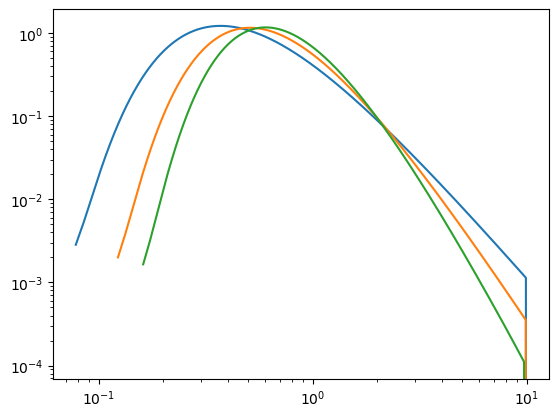

In [341]:
### Main setting
N = 50000
C = 500
alpha = 12
gamma = 4
maxW = 10


df = pd.DataFrame({"w": list(w_vec[:-1])+[10]})


for gamma in range(3,6):
    w_vec = w_truncated_inverse_gamma(N, gamma, maxW)
    density = [1/(N*(w_vec[i+1] - w_vec[i])) for i in range(N-1)] + [0]
    plt.yscale('log')
    plt.xscale('log')
    plt.plot(list(w_vec[:-1])+[10], density)
    df["gamma"+str(gamma)] = density
    
    
df.to_csv('fig4_inv_gamma.csv')

file_name = 'inv_gamma_loglog.png'
plt.savefig(file_name)


plt.show()

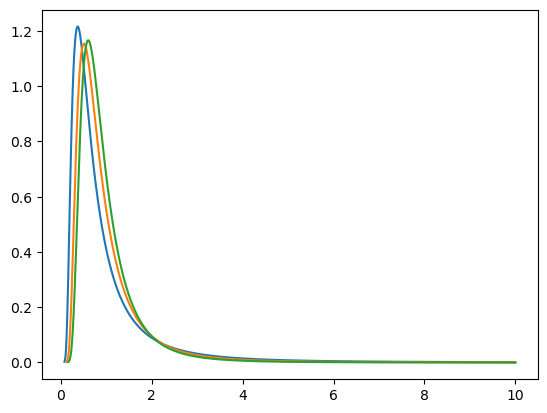

In [260]:
### Main setting
N = 50000
C = 500
alpha = 12
gamma = 4
maxW = 10



for gamma in range(3,6):
    w_vec = w_truncated_inverse_gamma(N, gamma, maxW)
    density = [1/(N*(w_vec[i+1] - w_vec[i])) for i in range(N-1)] + [0]
#     plt.yscale('log')
#     plt.xscale('log')
    plt.plot(list(w_vec[:-1])+[10], density)
    
file_name = 'inv_gammas.png'
plt.savefig(file_name)


plt.show()

In [277]:
### Main setting
N = 50000
C = 500
alpha = 12
gamma = 4
maxW = 10


# mod = init_Kuramoto_invGamma_file(N, C, gamma, maxW=maxW, verbose = True)   
w_vec = w_truncated_inverse_gamma(N, gamma, maxW)


In [35]:
df = pd.read_csv('data_Model1_100000_forAlphas.csv', index_col=0)
df

,N,alpha,C,gamma,maxW,sim_escape,estimated_spark_time,k_coeficient,coefLR,sigma,...,kbeta,M2,M3,preciscion_esc,limit_r_forced,std_r_forced,number_of_iterates,climb,sbeta,graph_filename
0,30000,10,300.0,3,10,3.219744,4.476615,81.293823,57.138721,0.005974,...,5.479943,2.141516,8.672748,0.035072,0.339457,0.033581,100000.0,3.089202,1.735166,invGamma_graph_30000_300_3_10.txt
0,30000,11,300.0,3,10,2.597390,3.626237,88.554719,59.628530,0.005974,...,5.004993,2.141516,8.672748,0.028821,0.321315,0.029269,100000.0,2.917333,1.462551,invGamma_graph_30000_300_3_10.txt
0,30000,31,300.0,3,10,10.240931,11.867331,60.546733,57.473396,0.005974,...,0.475388,2.141516,8.672748,0.143797,0.138283,0.003664,100000.0,4.403782,0.245444,invGamma_graph_30000_300_3_10.txt
0,30000,11,300.0,4,10,12.612470,21.361622,60.130892,55.878537,0.005308,...,3.271700,1.690176,5.090892,0.187206,0.346168,0.055465,100000.0,4.005747,1.235345,invGamma_graph_30000_300_4_10.txt
0,30000,10,300.0,4,10,19.529377,37.471629,54.359225,53.216574,0.005308,...,3.516514,1.690176,5.090892,0.336414,0.367736,0.054564,100000.0,4.571276,1.434488,invGamma_graph_30000_300_4_10.txt
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,30000,27,300.0,4,10,6.854610,9.308477,72.395083,61.697796,0.005308,...,0.730435,1.690176,5.090892,0.085476,0.168468,0.022316,100000.0,3.735677,0.230340,invGamma_graph_30000_300_4_10.txt
0,30000,29,300.0,3,10,6.806691,7.990869,66.912001,60.175280,0.005974,...,0.597984,2.141516,8.672748,0.084714,0.152805,0.007785,100000.0,3.803781,0.271493,invGamma_graph_30000_300_3_10.txt
0,30000,27,300.0,5,10,9.007064,13.708451,70.866775,60.964131,0.004923,...,0.705793,1.454388,3.364635,0.124452,0.154713,0.051455,100000.0,3.903077,0.171083,invGamma_graph_30000_300_5_10.txt
0,30000,29,300.0,4,10,8.862154,11.899525,68.224743,60.435338,0.005308,...,0.600021,1.690176,5.090892,0.122031,0.157616,0.007903,100000.0,3.900714,0.218510,invGamma_graph_30000_300_4_10.txt


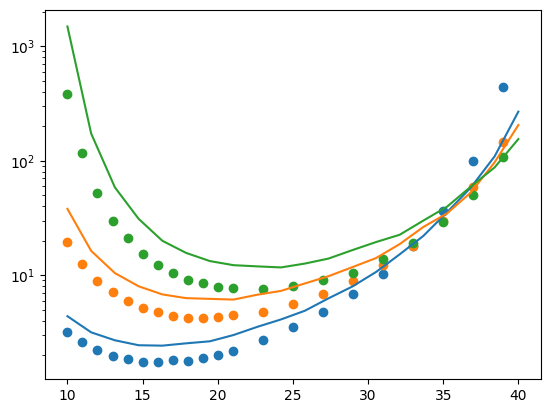

In [42]:
alphas = np.linspace(10, 40, 20)
N = 30000
maxW=10
C = 300

for gamma in [3,4,5]:
    w_vec = w_truncated_inverse_gamma(N, gamma, maxW)
    
    est_escapes = []

    for a in alphas:
        e = estimated_expected_time(w_vec, a, C)
        est_escapes.append(e)

    plt.yscale('log')
    plt.plot(alphas, est_escapes)
    plt.scatter(df.alpha[df.gamma == gamma], df.sim_escape[df.gamma == gamma])
    
    
    
file_name = 'escape_vs_alphas_fake.png'
plt.savefig(file_name)


plt.show()

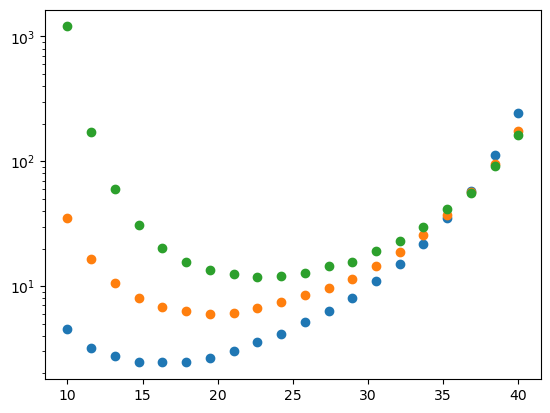

In [325]:
alphas = np.linspace(10, 40, 20)
C= 300
N = 30000

for gamma in [3,4,5]:
    w_vec = w_truncated_inverse_gamma(N, gamma, maxW)
    
    est_escapes = []

    for a in alphas:
        e = estimated_expected_time(w_vec, a, C)
        est_escapes.append(e)

    plt.yscale('log')
    plt.scatter(alphas, est_escapes)
    
    
    
file_name = 'escape_vs_alphas_fake.png'
plt.savefig(file_name)


plt.show()

In [9]:
### Main setting
N = 50000
C = 500
alpha = 12
gamma = 4
maxW = 10


mod = init_Kuramoto_invGamma_file(N, C, gamma, maxW=maxW, verbose = True)   

Generating model from edge-list. N=50000, C=500, g=4


In [14]:
getattr(mod, "E", 3)

3

In [298]:
e = mod.expected_stages_to_sync(1000)

In [43]:
1.85**0.5

1.3601470508735443

In [300]:
mod.estimated_expected_time()
f = force_sync(mod)
f

0.09186519937747188

1000.0

Generating model from edge-list. N=100000, C=1000, g=3


Generating model from edge-list. N=10000, C=300, g=3


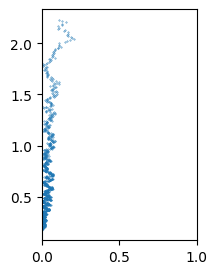

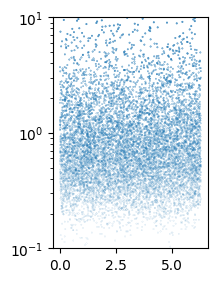

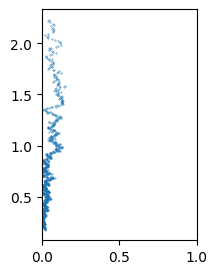

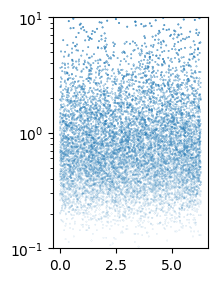

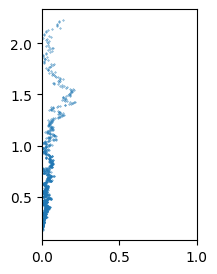

...

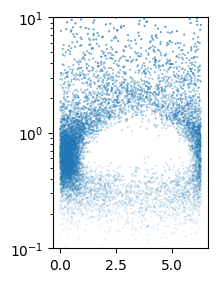

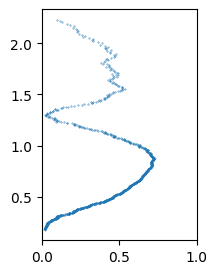

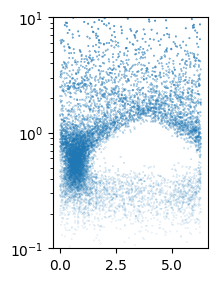

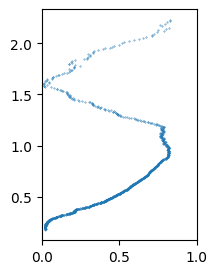

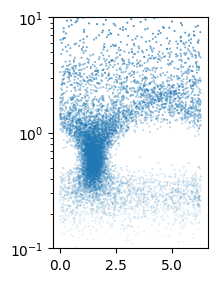

In [62]:
N = 10000
C = 300
gamma = 3
maxW = 10
alpha = 10

# w_vec = w_truncated_inverse_gamma(N, gamma, maxW)
mod = init_Kuramoto_invGamma_file(N, C, gamma, maxW=maxW, verbose = True)


mod.set_alpha(alpha)
mod.set_uniform()

splits = 1000
Ni = 300

steps = (N-Ni)//splits

states_df = pd.DataFrame({"w_vector": mod.w_vector})
bins_df = pd.DataFrame({"bins": list(range(0, splits+1))})

for ti in range(20):
    mod.one_step()
    rs = []
    ws = []
    
    for s in range(0, splits+1):
        min_i = steps * s 
        max_i = steps * s + Ni
        
        cos_vector_i = mod.cos_vector[min_i:max_i]
        sin_vector_i = mod.sin_vector[min_i:max_i]
        w_vector_i = mod.w_vector[min_i:max_i]

        c = np.dot(cos_vector_i, w_vector_i)/Ni
        s = np.dot(sin_vector_i, w_vector_i)/Ni

        r_i, theta_i = length_angle((c, s))
        rs.append(r_i)
        ws.append(np.mean(w_vector_i))
        
    bins_df['r_w'+str(ti)] = rs
    states_df['theta'+str(ti)] = mod.th_vector

    plt.figure(figsize=(2,3)) 
    plt.xlim(0,1)
    plt.scatter(rs, ws, s= 0.1)
    
    file_name = 'r_by_w_time_' + str(ti)+ '.png'
    plt.savefig(file_name)
    plt.show()
    

    
    plt.figure(figsize=(2,3)) 
    plt.yscale('log')
    plt.ylim(0.1,10)
    plt.scatter(mod.th_vector, mod.w_vector, s= (mod.w_vector)/50)

    file_name = 'scatter_points_time_' + str(ti)+ '.png'
    plt.savefig(file_name)
    plt.show()

    
bins_df['w_means'] = ws

bins_df.to_csv("fig1_N1e4_r_by_bins.csv")
states_df.to_csv("fig1_N1e4state_by_steps.csv")

In [319]:
states_df

,w_vector
0,0.074
1,0.081
2,0.084
3,0.086
4,0.088
...,...
99995,9.902
99996,9.911
99997,9.920
99998,9.929


In [1]:
%run ./Kuramoto.ipynb

# figure for first paper

In [62]:
N = 100000
C = 1000
gamma = 3
maxW = 100
t_averages = 10
T_stabilization = 10

figures_last_r(N, C, gamma, maxW, t_averages, T_stabilization)


Generating model from edge-list. N=100000, C=1000, g=3
alpha: 3.0      r= 0.25037729897674976


IndexError: list index out of range

In [82]:
N = 100000
C = 100
gamma = 3
maxW = 100

mod1 = init_Kuramoto_invGamma_file(N, C, gamma, maxW=maxW, verbose = True)   # initiate setting for the model

Generating w-vector. N=100000, C=100, g=3
Generating random-graph.
Generating random graph: Step 1: Nodes left 10000000
Generating random graph: Step 1: Nodes left 74442
Generating random graph: Step 1: Nodes left 17044
Generating random graph: Step 1: Nodes left 10920
Generating random graph: Step 2.0: Nodes left 9052
Generating model from edge-list. N=100000, C=100, g=3


In [104]:
mod1.set_alpha(7)
mod1.estimated_expected_time()

1826.2888888888888

In [99]:
mod1.alpha

23.876104167282428

0.005886141776732898


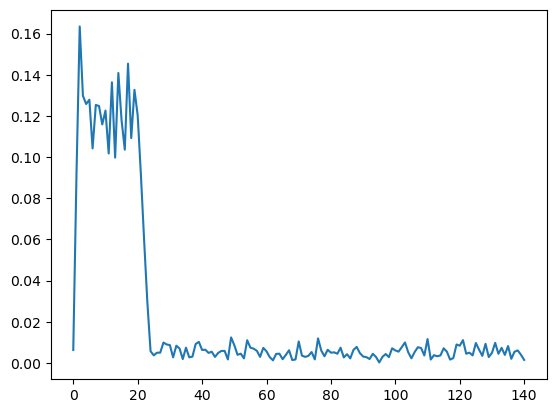

In [98]:
print(force_sync(mod1))
for _ in range(100): mod1.one_step()

plt.plot(mod1.r_historic)

alpha: 4.0      r= 0.005956969727689004
alpha: 3.8      r= 0.005143145561459459
alpha: 3.6      r= 0.006122627923260909
alpha: 3.4      r= 0.005615042061348865
alpha: 3.2      r= 0.0061153402590528715
alpha: 3.0      r= 0.005495679522419874
alpha: 2.8      r= 0.004791164682189144
alpha: 2.6      r= 0.005733710933881483
alpha: 2.4      r= 0.005969664947255651
alpha: 2.2      r= 0.006141672995738225
alpha: 2.0      r= 0.005884398054845614
alpha: 1.8      r= 0.005982008528507189
alpha: 1.6      r= 0.006640868408190334
alpha: 1.4      r= 0.0068100268865781055
alpha: 1.2      r= 0.006611422708569807
alpha: 1.0      r= 0.008086540534599123
alpha: 0.8      r= 0.006384477067138131
alpha: 0.6      r= 0.4098239732628843
alpha: 0.4      r= 0.3788348570746461
alpha: 0.39      r= 0.3740468872107753
alpha: 0.38      r= 0.366123241865736
alpha: 0.37      r= 0.35901316362873287
alpha: 0.36      r= 0.3512634712427498
alpha: 0.35      r= 0.34432848694885854
alpha: 0.34      r= 0.33576646343365707
alpha:

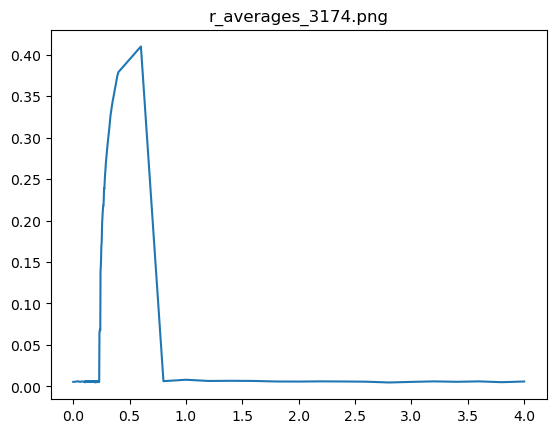

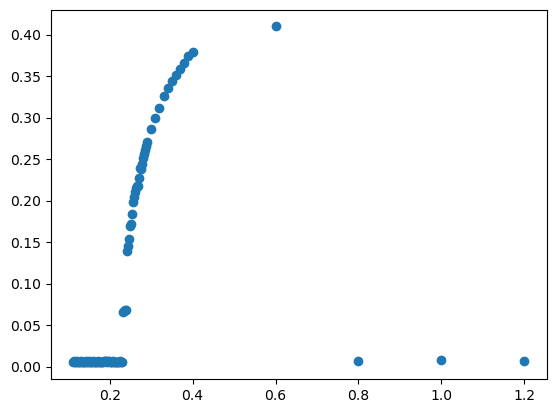

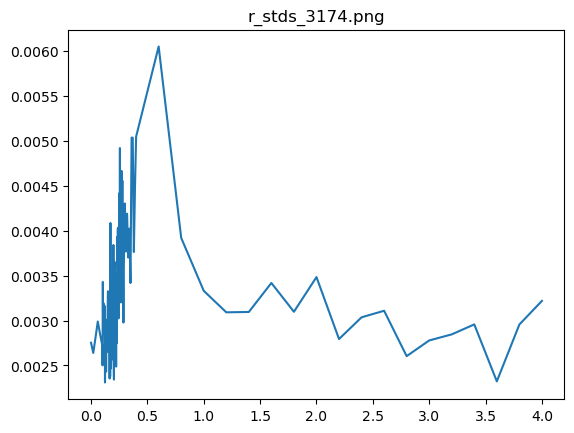

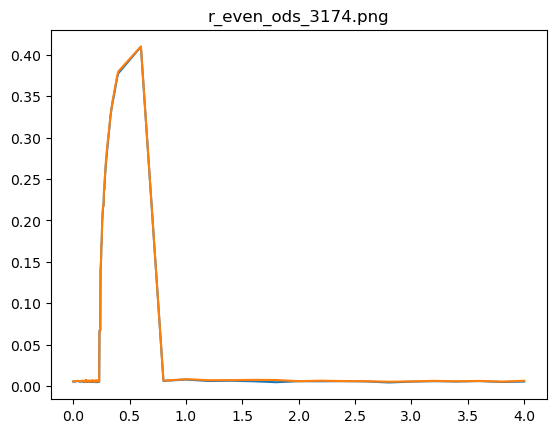

In [105]:
T_for_averages = 50


starting_time = time.time()    

alphas = np.concatenate((np.linspace(4,0.4, 19), np.linspace(0.39, 0.3, 10), np.linspace(0.29, 0.1, 80) , np.linspace(0.08, 0, 5)))     
tes = [10] + [10]*10 + [1000]*8 + [1000]* 90 + [10]*5
#tes = [1000] * 250 + [1000]* 40 + [1000]*11

r_averages = []
r_stds = []

length_for_even_ods = 50
r_average_odds = []
r_average_evens = []

for t, a in zip(tes, alphas):
    mod1.set_alpha(2*np.pi * a)   # Mupltiplying by 2 pi because they use alpha for [0,1]
    
    # Run first t steps to get to synchronization, and the T_for_averages more to record values 
    for _ in range(t): mod1.one_step()
    mod1.r_historic = []
    mod1.theta_historic = []
    for _ in range(T_for_averages): mod1.one_step()

    print("alpha:", np.around(a,3), "     r=" , np.mean(mod1.r_historic))

    r_averages.append(np.mean(mod1.r_historic))
    r_stds.append(np.std(mod1.r_historic))

    T =  len(mod1.r_historic)
    last_odds = np.mean([mod1.r_historic[i] for i in range(T-length_for_even_ods-1, T-1, 2)])
    last_evens = np.mean([mod1.r_historic[i] for i in range(T-length_for_even_ods, T, 2)])

    last_min =  min(last_odds, last_evens)
    last_max =  max(last_odds, last_evens)

    r_average_odds.append(last_min)
    r_average_evens.append(last_max)
    

ending_time = time.time()    
print("Elapsed Time:", np.around((ending_time-starting_time)/60, 2))

    
code = str(np.random.randint(10000))

plt.plot(alphas, r_averages)
plt.title("r_averages_" + code + ".png")
plt.savefig("r_averages_" + code + ".png")
plt.show()

plt.scatter(alphas[-100:-10], r_averages[-100:-10])
plt.show()


plt.plot(alphas, r_stds)
plt.title("r_stds_" + code + ".png")
plt.savefig("r_stds_" + code + ".png")
plt.show()

plt.plot(alphas, r_average_odds)
plt.plot(alphas, r_average_evens)
plt.title("r_even_ods_" + code + ".png")

plt.savefig("r_even_ods_" + code + ".png")
plt.show()


df= pd.DataFrame(data = {'alpha': alphas, "r_averages": r_averages, "r_stds": r_stds, 'r_average_odds':r_average_odds, 'r_average_evens':r_average_evens})
df.to_csv('r_averages_' + code + '.csv')


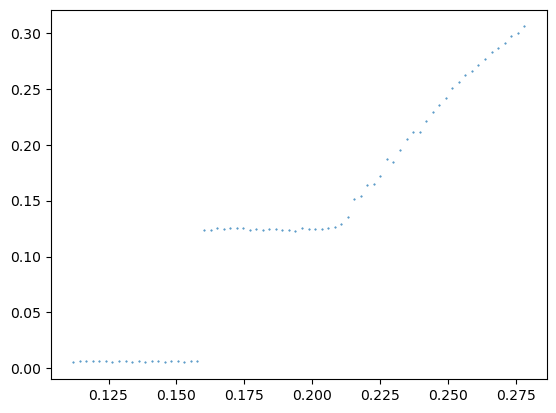

In [79]:
plt.scatter(alphas[-80:-10], r_averages[-80:-10], s=0.2)
plt.show()


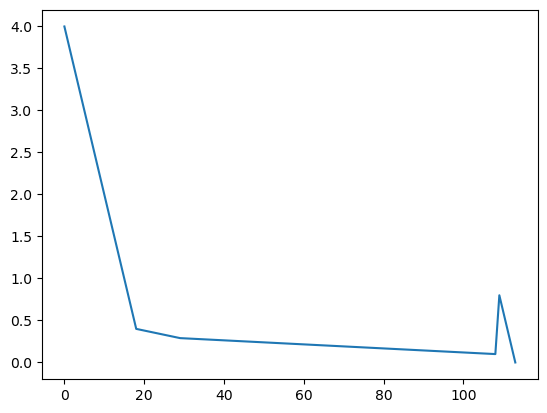

In [80]:
plt.plot(alphas)

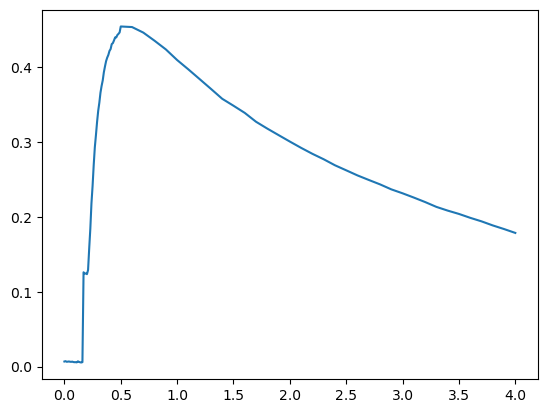

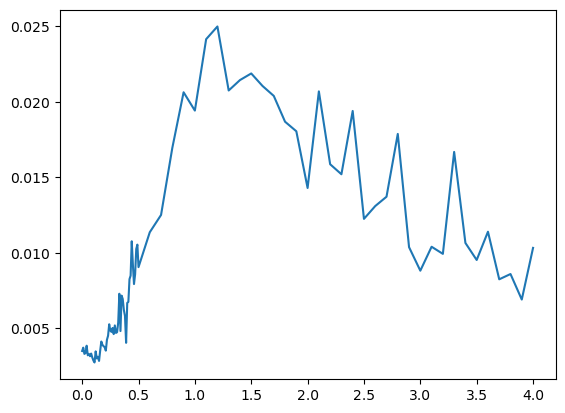

In [74]:
plt.plot(alphas, r_averages)
plt.show()



plt.plot(alphas, r_stds)
plt.show()


In [52]:
len(r_average_odds[1])

10

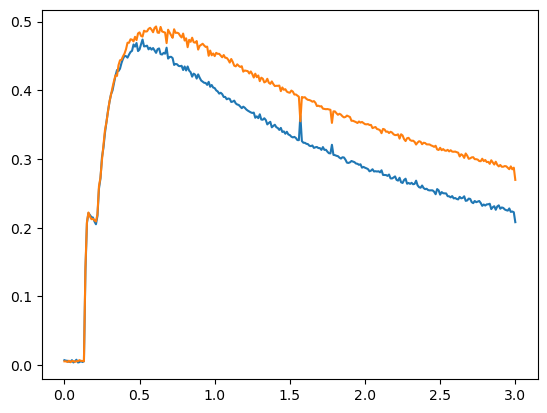

In [56]:
plt.plot(alphas, r_average_odds)
plt.plot(alphas, r_average_evens)
plt.show()



In [65]:
3/(2*np.pi* 0.2*0.2)

11.93662073189215

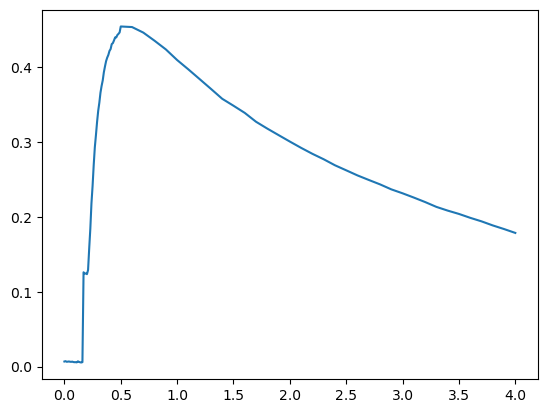

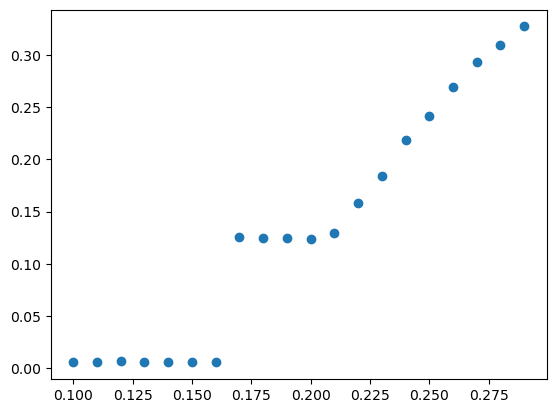

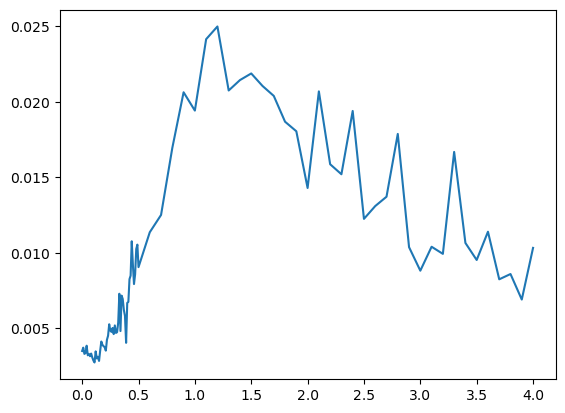

In [75]:
plt.plot(alphas, r_averages)
# plt.savefig("r_averages.png")
plt.show()

plt.scatter(alphas[-30:-10], r_averages[-30:-10])
plt.show()



plt.plot(alphas, r_stds)
# plt.savefig("r_stds.png")
plt.show()




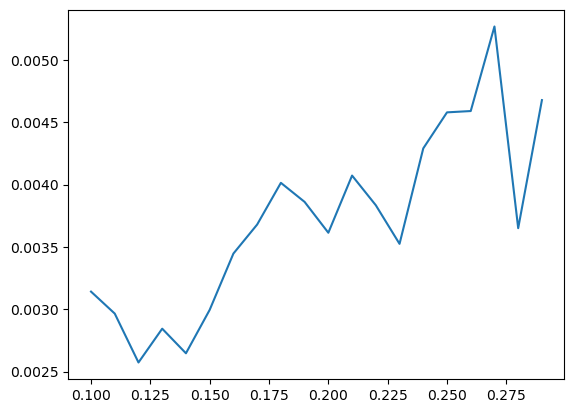

In [34]:
plt.plot(alphas[-30:-10], r_stds[-30:-10])


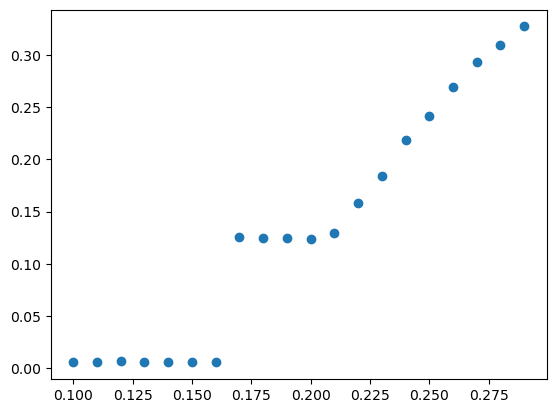

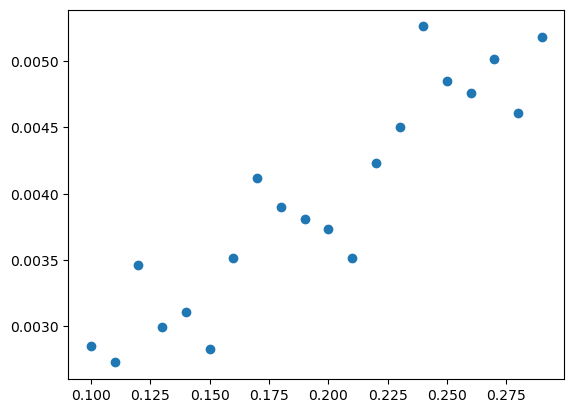

In [73]:
plt.scatter(alphas[-30:-10], r_averages[-30:-10])
plt.show()

plt.scatter(alphas[-30:-10], r_stds[-30:-10])
plt.show()


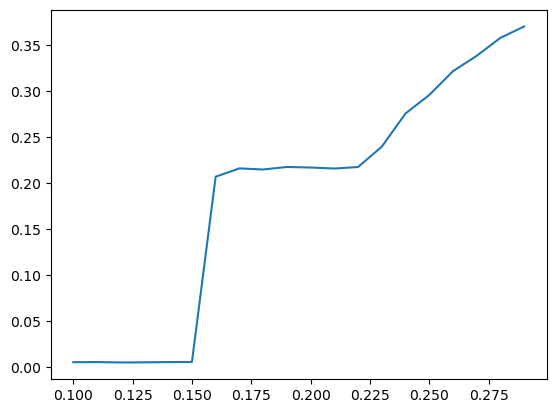

In [24]:
plt.plot(alphas[-30:-10], r_averages[-30:-10])


In [13]:
N = 100000
C = 1000
gamma = 3
maxW = 10

mod = init_Kuramoto_invGamma_file(N, C, gamma, maxW=maxW, verbose = True)   # initiate setting for the model

mod.set_alpha(15)
mod.estimated_expected_time()

Generating model from edge-list. N=100000, C=1000, g=3


2.21322849213691